In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy
pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_month.nc")
ocean_daily_wave_1

In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_oneway_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_oneway_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
pp_root_oneway_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_all/"
pp_root_oneway="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_dT"


def read_and_extract_data_weightedmean(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        mean_sum = None
        count_sum = None
        summer_mean_sum = None
        summer_count_sum = None
        winter_mean_sum = None
        winter_count_sum = None

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        # Compute valid count (to weight the mean correctly)
                        count_valid = ds[var_name].notnull().sum(dim='time')
                        
                        if count_valid.sum() > 0:
                            yearly_mean = ds[var_name].sum(dim='time', skipna=True)
                            
                            if mean_sum is None:
                                mean_sum = yearly_mean
                                count_sum = count_valid
                            else:
                                mean_sum += yearly_mean
                                count_sum += count_valid

                        # Summer (JJA): June, July, August
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        summer_count_valid = summer[var_name].notnull().sum(dim='time')
                        
                        if summer_count_valid.sum() > 0:
                            summer_mean = summer[var_name].sum(dim='time', skipna=True)
                            
                            if summer_mean_sum is None:
                                summer_mean_sum = summer_mean
                                summer_count_sum = summer_count_valid
                            else:
                                summer_mean_sum += summer_mean
                                summer_count_sum += summer_count_valid

                        # Winter (DJF): December, January, February
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        winter_count_valid = winter[var_name].notnull().sum(dim='time')
                        
                        if winter_count_valid.sum() > 0:
                            winter_mean = winter[var_name].sum(dim='time', skipna=True)
                            
                            if winter_mean_sum is None:
                                winter_mean_sum = winter_mean
                                winter_count_sum = winter_count_valid
                            else:
                                winter_mean_sum += winter_mean
                                winter_count_sum += winter_count_valid

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Compute final means
        combined_data[var_name] = mean_sum / count_sum if count_sum is not None else None
        summer_data[var_name] = summer_mean_sum / summer_count_sum if summer_count_sum is not None else None
        winter_data[var_name] = winter_mean_sum / winter_count_sum if winter_count_sum is not None else None

    return combined_data, summer_data, winter_data

Ddata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',


]

Mdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',


]
WMdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19960701_results/19960701.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19970701_results/19970701.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19980701_results/19980701.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '19990701_results/19990701.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20000701_results/20000701.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20010701_results/20010701.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20020701_results/20020701.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20030701_results/20030701.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
 
]

WDdata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19960701_results/19960701.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19970701_results/19970701.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19980701_results/19980701.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '19990701_results/19990701.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20000701_results/20000701.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20010701_results/20010701.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20020701_results/20020701.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20030701_results/20030701.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20040701_results/20040701.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc',
   
]

One_D_list=[
    '19930101_results/19930101.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_D_all_list=[
    '19930101_results/19930101.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_M_list=[
    '19930101_results/19930101.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc', 
]
One_M_all_list=[
    '19930101_results/19930101.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc'
]

# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR','La_turbulent','surface_stokes_x','surface_stokes_y']
# variables_month = ['ssh','speed','MLD_EN1','MSTAR','ustar']
# variables_daily = ['omldamax','SST']
variables_month = ['MSTAR','ustar']

# Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Ddata_list, variables_daily)
Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Mdata_list, variables_month)

# Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WDdata_list, variables_daily)
Mcombined_data_6_wave, Msummer_data_6_wave, Mwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WMdata_list, variables_month)

# Dcombined_data_oneway_all, Dsummer_data_oneway_all, Dwinter_data_oneway_all = read_and_extract_data_weightedmean(pp_root_oneway_all, One_D_all_list, variables_daily)
Mcombined_data_oneway_all, Msummer_data_oneway_all, Mwinter_data_oneway_all = read_and_extract_data_weightedmean(pp_root_oneway_all, One_M_all_list, variables_month)

# Dcombined_data_oneway, Dsummer_data_oneway, Dwinter_data_oneway = read_and_extract_data_weightedmean(pp_root_oneway, One_D_list, variables_daily)
Mcombined_data_oneway, Msummer_data_oneway, Mwinter_data_oneway = read_and_extract_data_weightedmean(pp_root_oneway, One_M_list, variables_month)


ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']



/vftmp/Qian.Xiao/pid3131280/ipykernel_3134014/4161169629.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3131280/ipykernel_3134014/4161169629.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3131280/ipykernel_3134014/4161169629.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3131280/ipykernel_3134014/4161169629.py:42: FutureWarning: In a future version of xarray dec

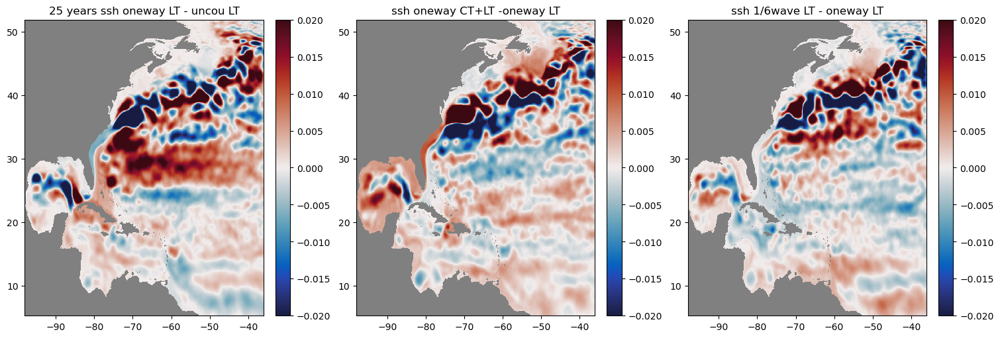

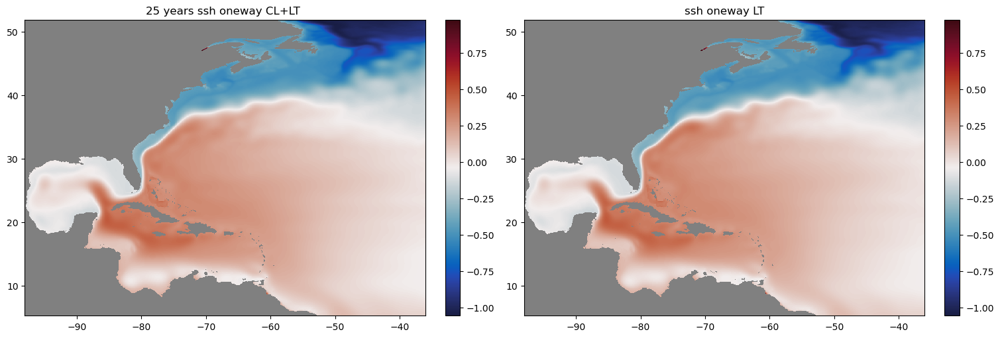

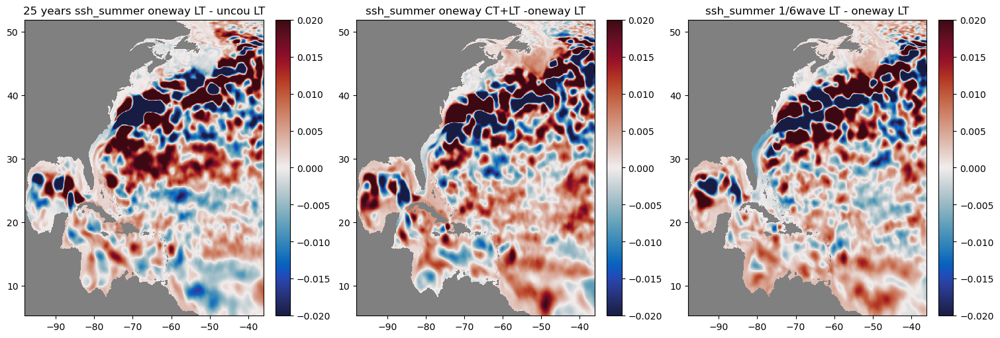

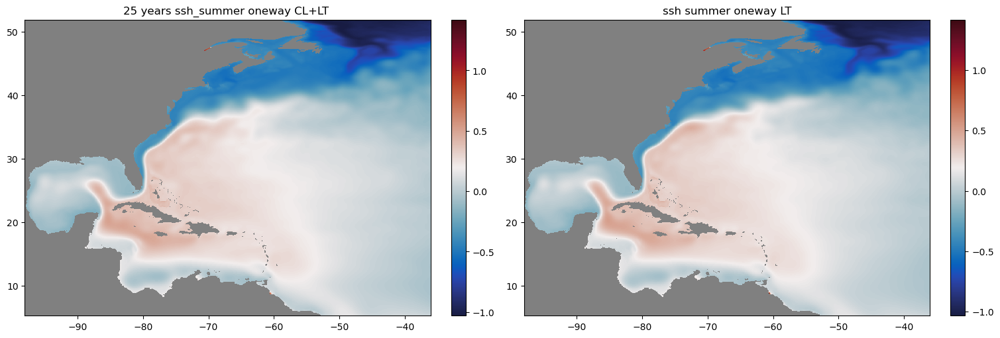

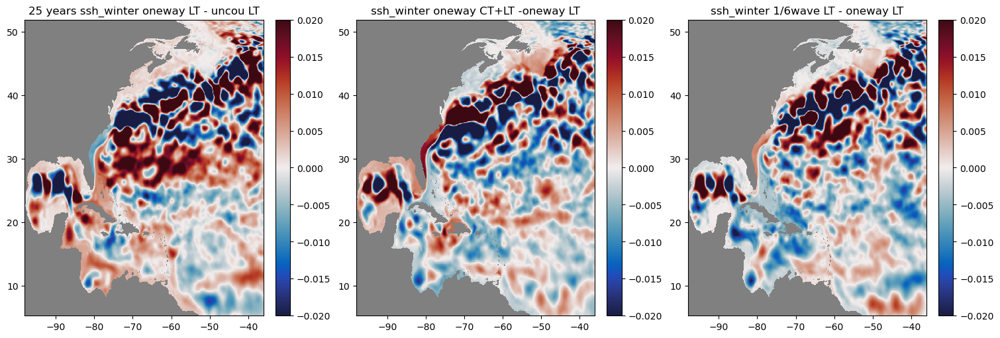

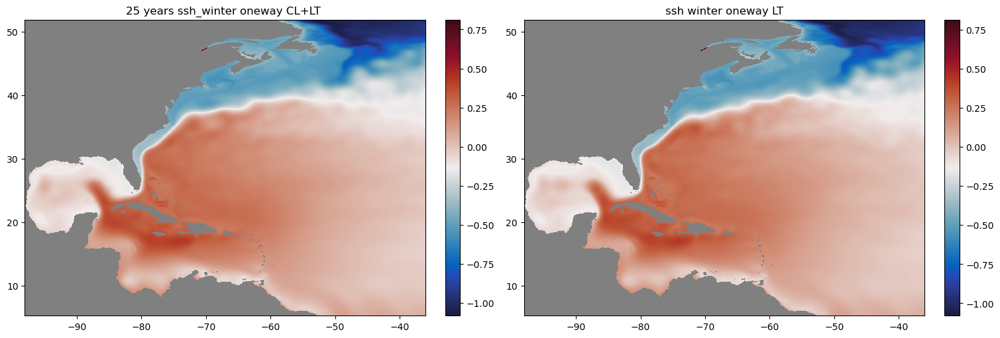

In [8]:
ssh_uncou_ave= Mcombined_data_uncou['ssh']
ssh_summer_uncou_ave= Msummer_data_uncou['ssh']
ssh_winter_uncou_ave= Mwinter_data_uncou['ssh']

ssh_oneway_all_ave= Mcombined_data_oneway_all['ssh']
ssh_summer_oneway_all_ave= Msummer_data_oneway_all['ssh']
ssh_winter_oneway_all_ave= Mwinter_data_oneway_all['ssh']

ssh_oneway_ave= Mcombined_data_oneway['ssh']
ssh_summer_oneway_ave= Msummer_data_oneway['ssh']
ssh_winter_oneway_ave= Mwinter_data_oneway['ssh']

ssh_6_wave_ave= Mcombined_data_6_wave['ssh']
ssh_summer_6_wave_ave= Msummer_data_6_wave['ssh']
ssh_winter_6_wave_ave= Mwinter_data_6_wave['ssh']

diff_ssh_uncou_ave=ssh_oneway_ave - ssh_uncou_ave
diff_ssh_all_ave=ssh_oneway_all_ave-ssh_oneway_ave
diff_ssh_wave_ave=ssh_6_wave_ave - ssh_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[0].set_title('25 years ssh oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_all_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[1].set_title('ssh oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_wave_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[2].set_title('ssh 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years ssh oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_ssh_summer_uncou_ave=ssh_summer_oneway_ave - ssh_summer_uncou_ave
diff_ssh_summer_all_ave=ssh_summer_oneway_all_ave-ssh_summer_oneway_ave
diff_ssh_summer_wave_ave=ssh_summer_6_wave_ave - ssh_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[0].set_title('25 years ssh_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[1].set_title('ssh_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[2].set_title('ssh_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years ssh_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_ssh_winter_uncou_ave=ssh_winter_oneway_ave - ssh_winter_uncou_ave
diff_ssh_winter_all_ave=ssh_winter_oneway_all_ave-ssh_winter_oneway_ave
diff_ssh_winter_wave_ave=ssh_winter_6_wave_ave - ssh_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[0].set_title('25 years ssh_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[1].set_title('ssh_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.02,vmax=0.02)
axes[2].set_title('ssh_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years ssh_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

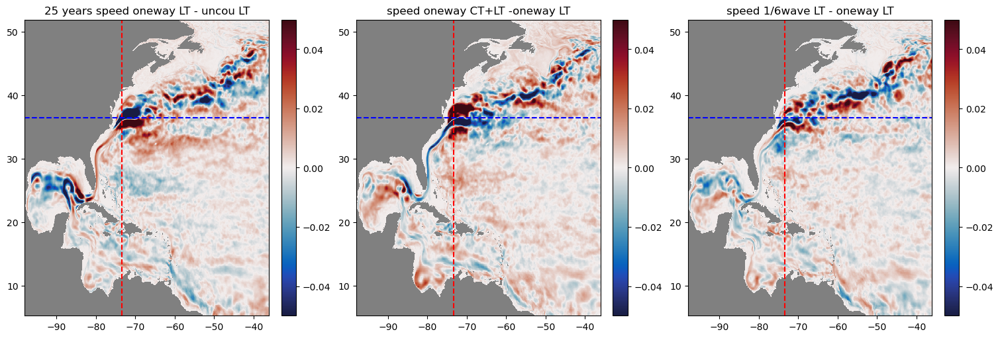

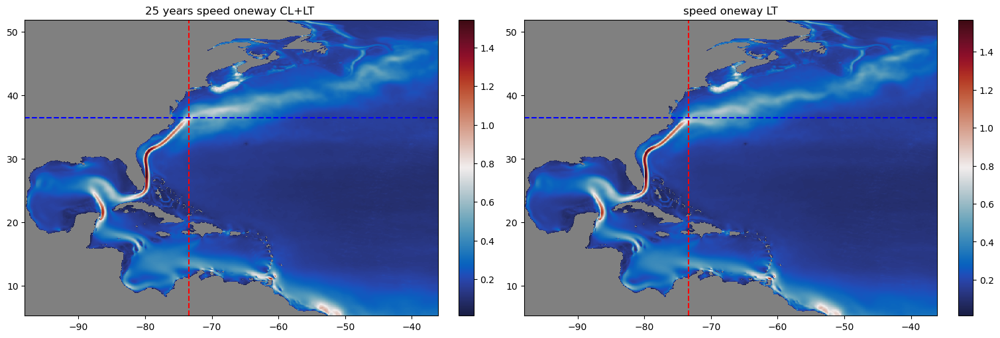

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/903194021.py:70: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


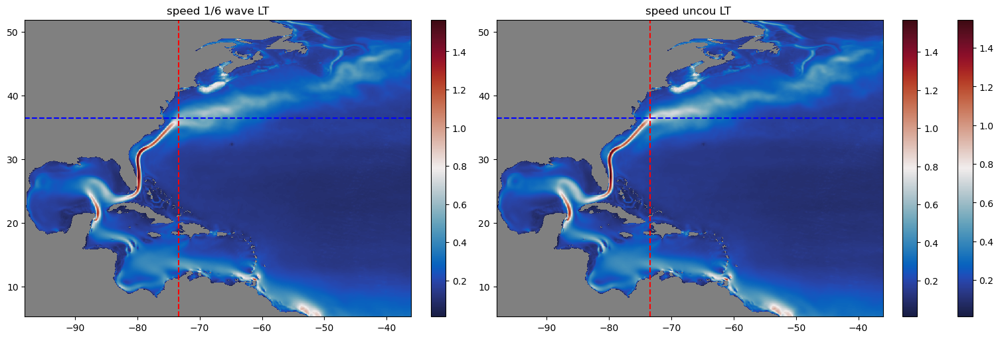

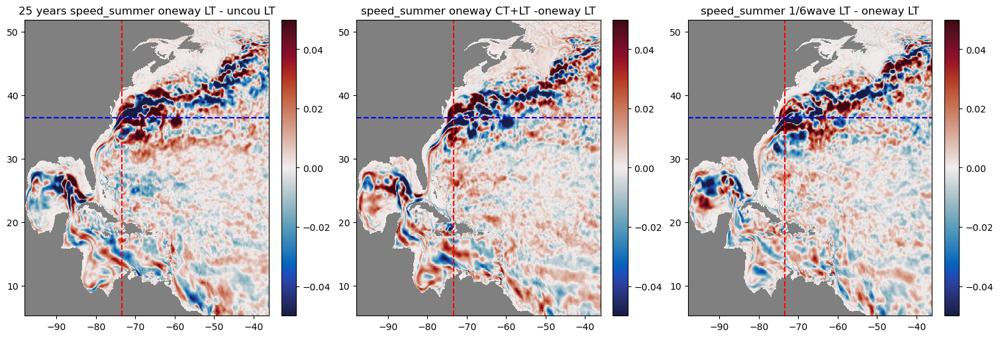

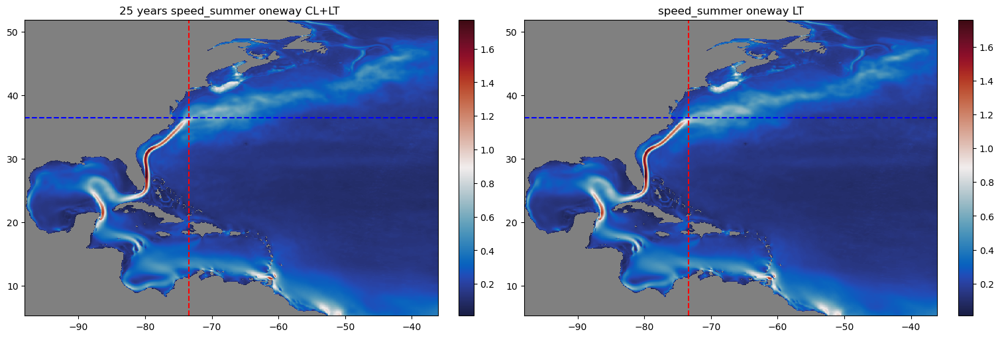

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/903194021.py:132: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


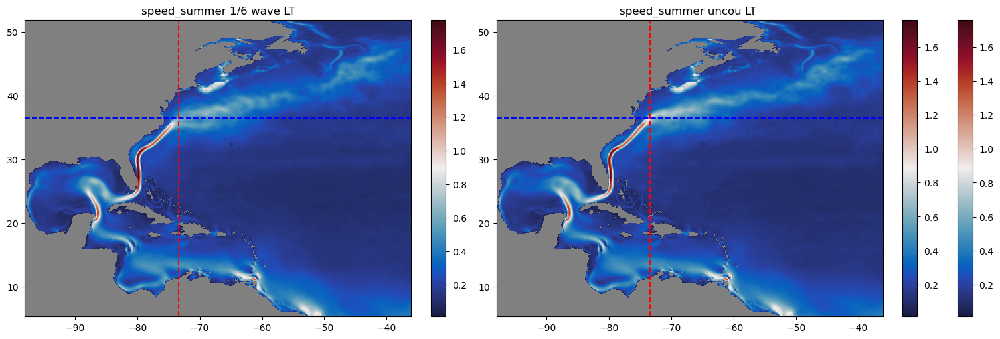

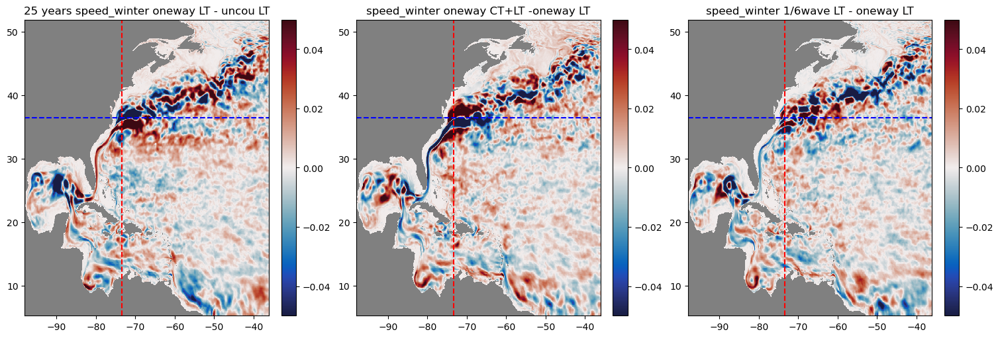

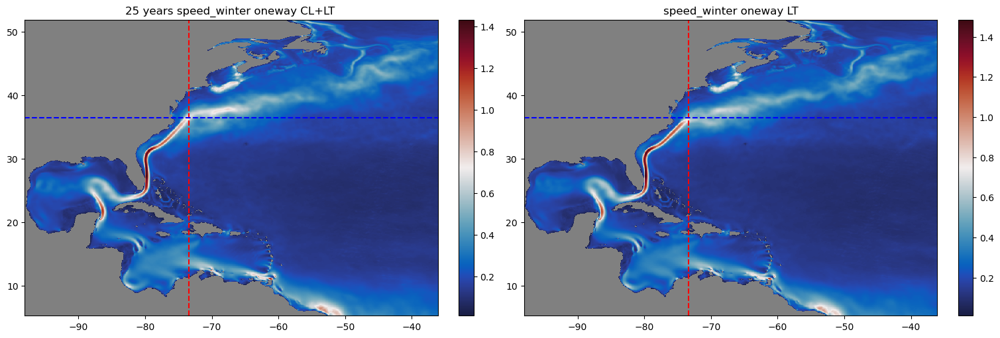

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/903194021.py:193: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


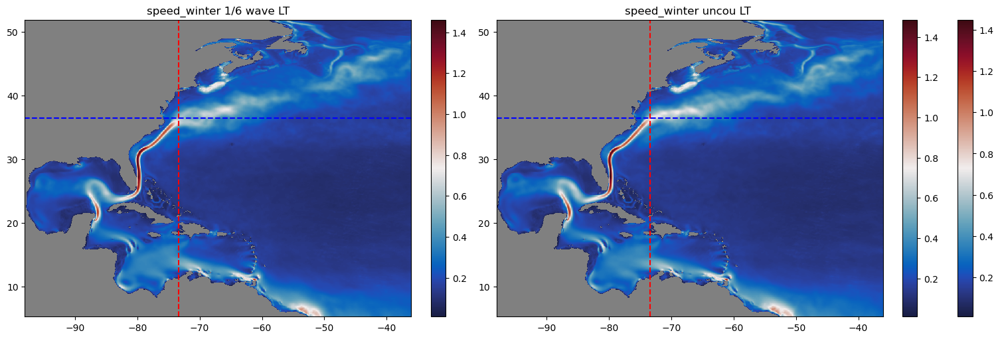

In [14]:
speed_uncou_ave= Mcombined_data_uncou['speed']
speed_summer_uncou_ave= Msummer_data_uncou['speed']
speed_winter_uncou_ave= Mwinter_data_uncou['speed']

speed_oneway_all_ave= Mcombined_data_oneway_all['speed']
speed_summer_oneway_all_ave= Msummer_data_oneway_all['speed']
speed_winter_oneway_all_ave= Mwinter_data_oneway_all['speed']

speed_oneway_ave= Mcombined_data_oneway['speed']
speed_summer_oneway_ave= Msummer_data_oneway['speed']
speed_winter_oneway_ave= Mwinter_data_oneway['speed']

speed_6_wave_ave= Mcombined_data_6_wave['speed']
speed_summer_6_wave_ave= Msummer_data_6_wave['speed']
speed_winter_6_wave_ave= Mwinter_data_6_wave['speed']

diff_speed_uncou_ave=speed_oneway_ave - speed_uncou_ave
diff_speed_all_ave=speed_oneway_all_ave-speed_oneway_ave
diff_speed_wave_ave=speed_6_wave_ave - speed_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()


diff_speed_summer_uncou_ave=speed_summer_oneway_ave - speed_summer_uncou_ave
diff_speed_summer_all_ave=speed_summer_oneway_all_ave-speed_summer_oneway_ave
diff_speed_summer_wave_ave=speed_summer_6_wave_ave - speed_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed_summer 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed_summer uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()

diff_speed_winter_uncou_ave=speed_winter_oneway_ave - speed_winter_uncou_ave
diff_speed_winter_all_ave=speed_winter_oneway_all_ave-speed_winter_oneway_ave
diff_speed_winter_wave_ave=speed_winter_6_wave_ave - speed_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed_winter 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed_winter uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
plt.show()

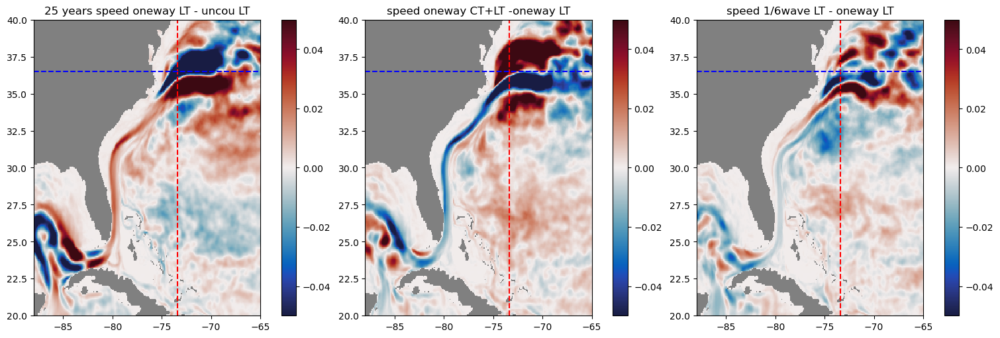

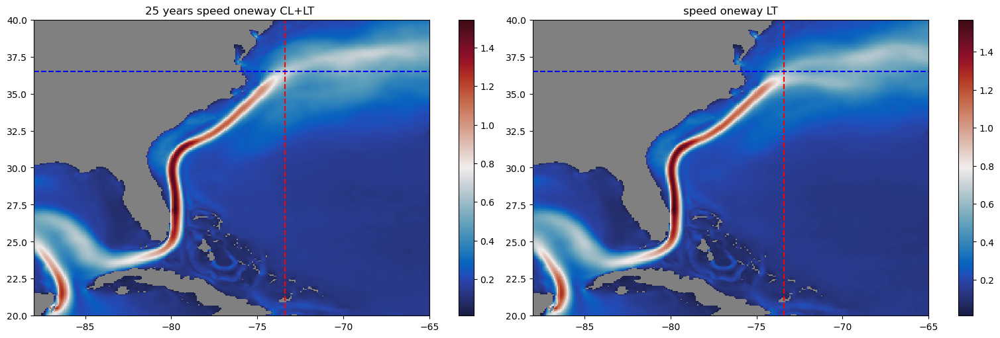

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/2622506671.py:80: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


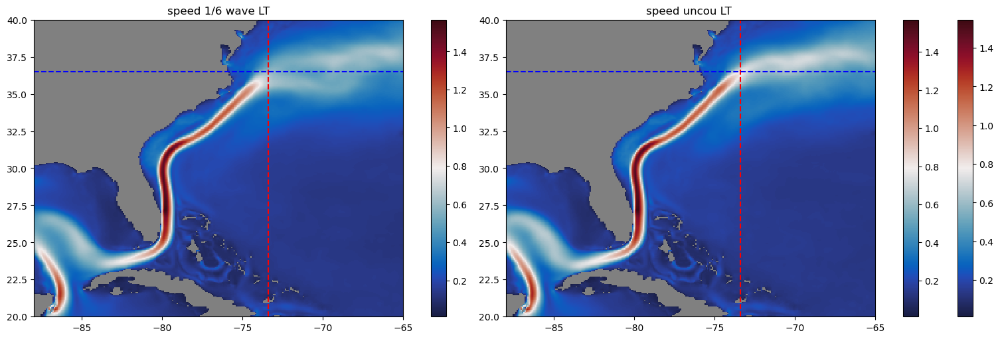

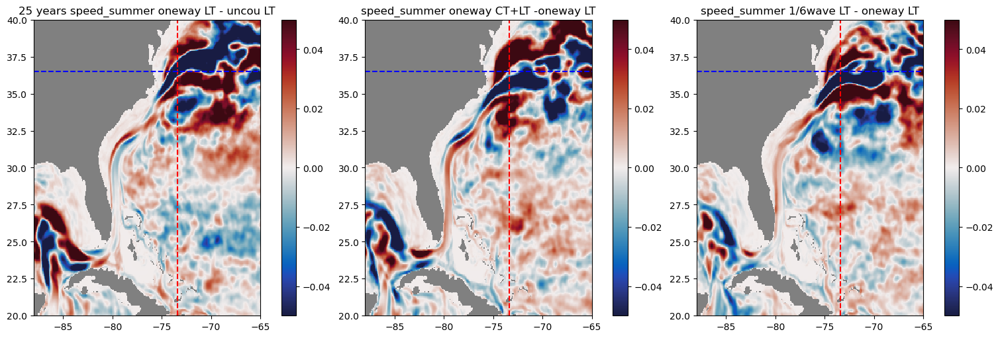

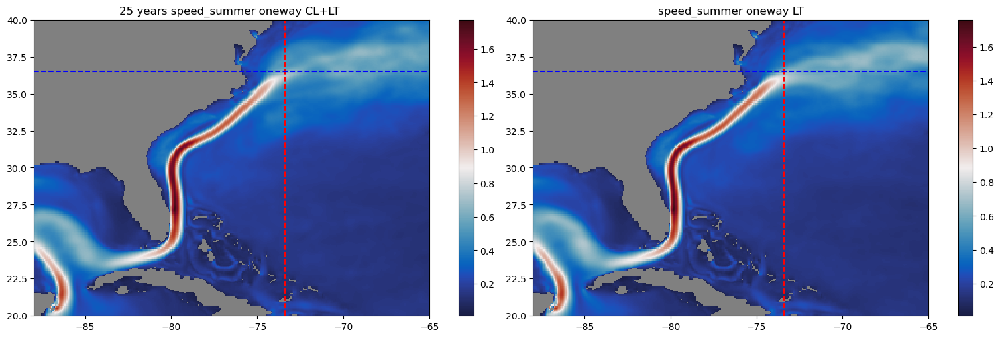

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/2622506671.py:156: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


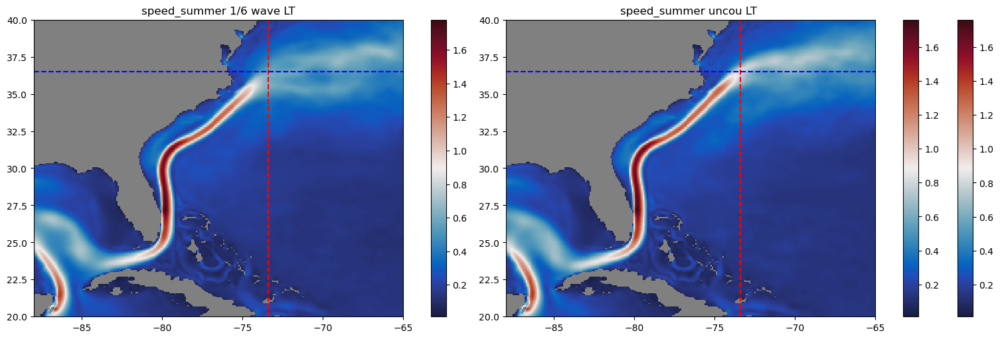

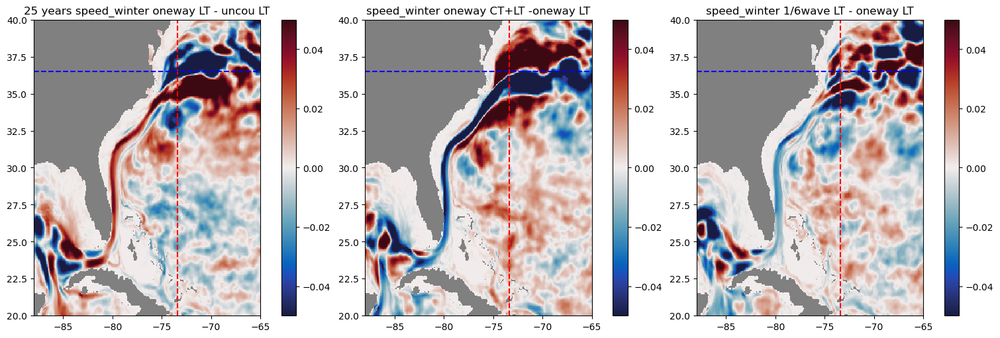

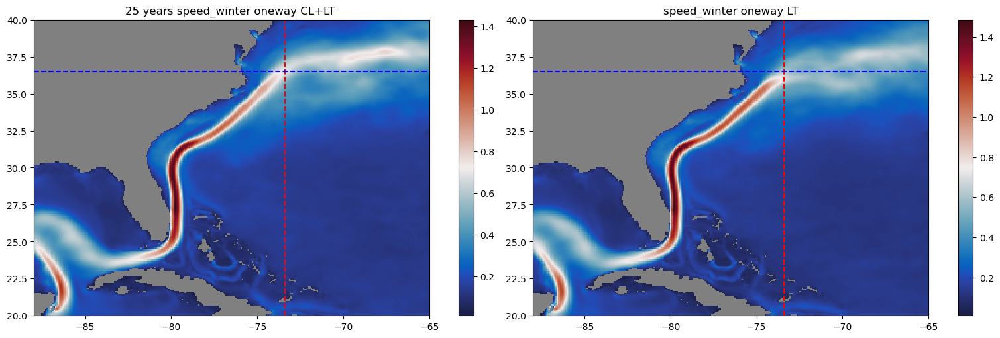

/vftmp/Qian.Xiao/pid2005190/ipykernel_2227855/2622506671.py:231: UserWarning: Adding colorbar to a different Figure <Figure size 1500x500 with 4 Axes> than <Figure size 1500x500 with 5 Axes> which fig.colorbar is called on.
  plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


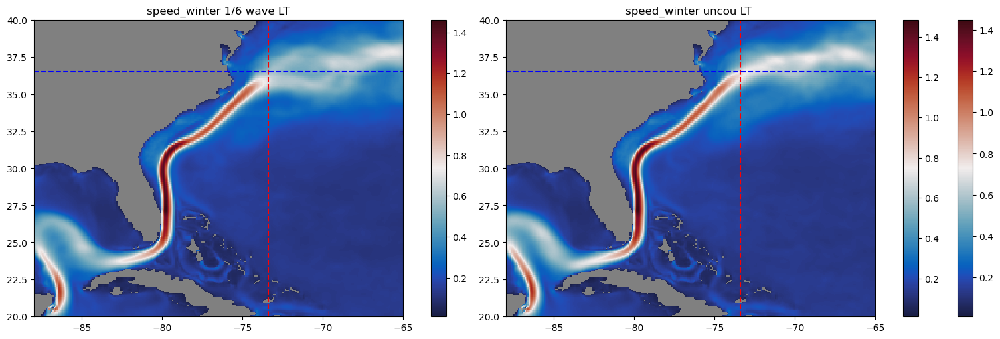

In [15]:
speed_uncou_ave= Mcombined_data_uncou['speed']
speed_summer_uncou_ave= Msummer_data_uncou['speed']
speed_winter_uncou_ave= Mwinter_data_uncou['speed']

speed_oneway_all_ave= Mcombined_data_oneway_all['speed']
speed_summer_oneway_all_ave= Msummer_data_oneway_all['speed']
speed_winter_oneway_all_ave= Mwinter_data_oneway_all['speed']

speed_oneway_ave= Mcombined_data_oneway['speed']
speed_summer_oneway_ave= Msummer_data_oneway['speed']
speed_winter_oneway_ave= Mwinter_data_oneway['speed']

speed_6_wave_ave= Mcombined_data_6_wave['speed']
speed_summer_6_wave_ave= Msummer_data_6_wave['speed']
speed_winter_6_wave_ave= Mwinter_data_6_wave['speed']

diff_speed_uncou_ave=speed_oneway_ave - speed_uncou_ave
diff_speed_all_ave=speed_oneway_all_ave-speed_oneway_ave
diff_speed_wave_ave=speed_6_wave_ave - speed_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()


diff_speed_summer_uncou_ave=speed_summer_oneway_ave - speed_summer_uncou_ave
diff_speed_summer_all_ave=speed_summer_oneway_all_ave-speed_summer_oneway_ave
diff_speed_summer_wave_ave=speed_summer_6_wave_ave - speed_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed_summer 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed_summer uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()

diff_speed_winter_uncou_ave=speed_winter_oneway_ave - speed_winter_uncou_ave
diff_speed_winter_all_ave=speed_winter_oneway_all_ave-speed_winter_oneway_ave
diff_speed_winter_wave_ave=speed_winter_6_wave_ave - speed_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[0].set_title('25 years speed_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[1].set_title('speed_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('speed_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years speed_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the second dataset

mesh3 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave  , cmap=cmap, shading='auto')
axes[0].set_title('speed_winter 1/6 wave LT')
plt.colorbar(mesh3, ax=axes[0])  # Add colorbar for the first plot

mesh4 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave  , cmap=cmap, shading='auto')
axes[1].set_title('speed_winter uncou LT ')
plt.colorbar(mesh4, ax=axes[1])  # Add colorbar for the first plot
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.show()

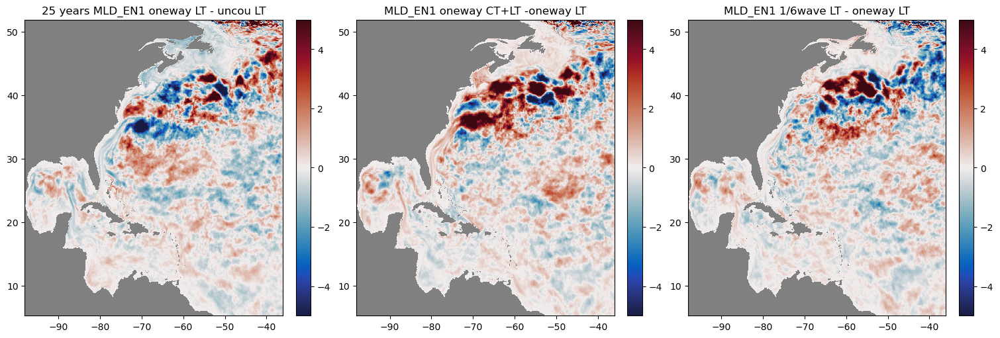

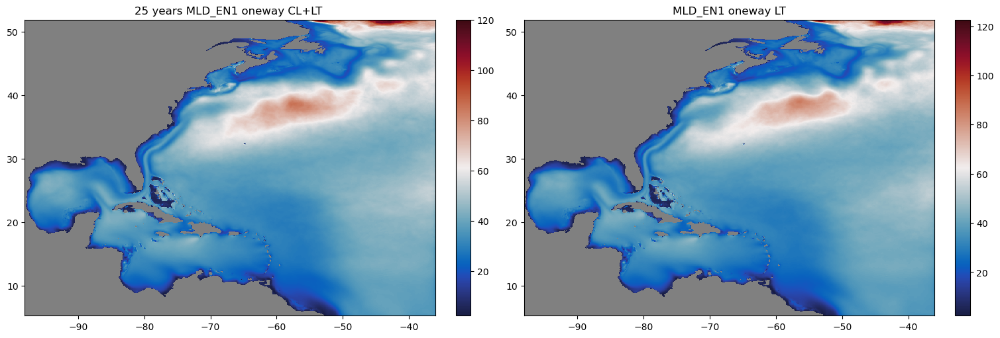

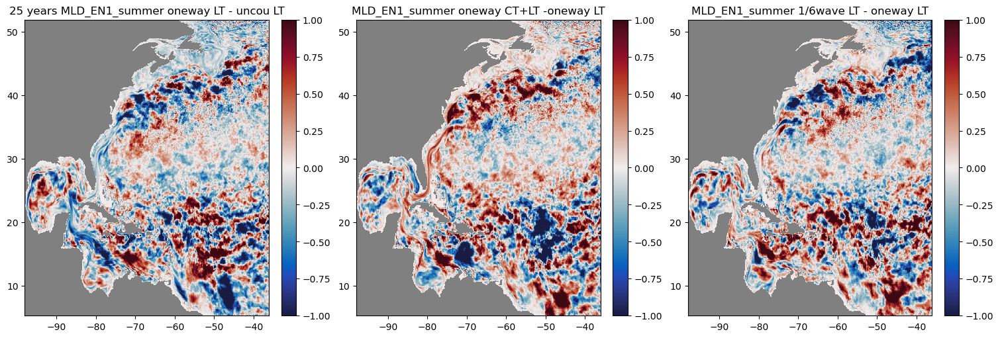

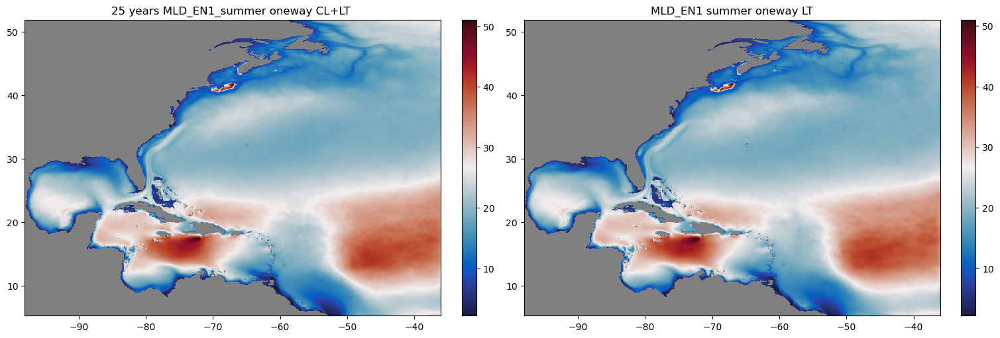

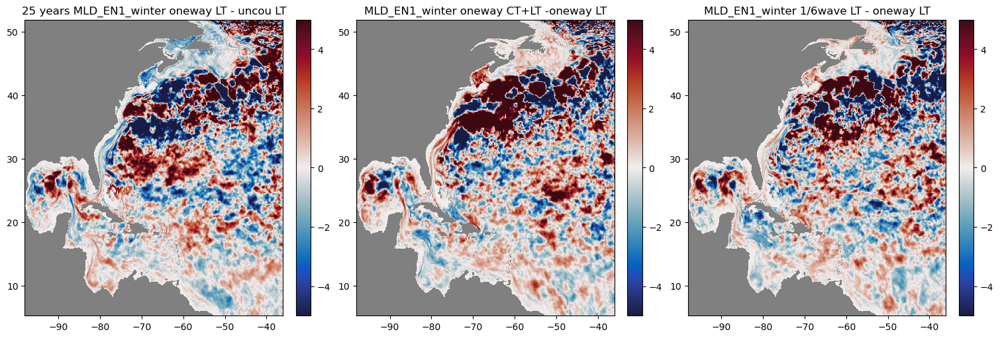

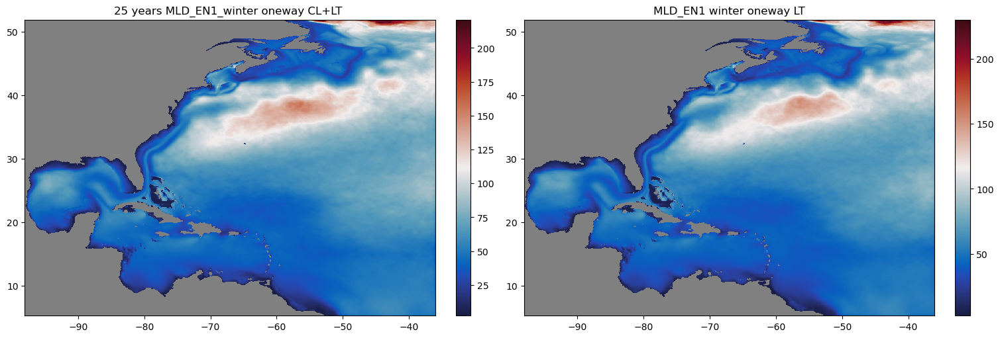

In [20]:
MLD_EN1_uncou_ave= Mcombined_data_uncou['MLD_EN1']
MLD_EN1_summer_uncou_ave= Msummer_data_uncou['MLD_EN1']
MLD_EN1_winter_uncou_ave= Mwinter_data_uncou['MLD_EN1']

MLD_EN1_oneway_all_ave= Mcombined_data_oneway_all['MLD_EN1']
MLD_EN1_summer_oneway_all_ave= Msummer_data_oneway_all['MLD_EN1']
MLD_EN1_winter_oneway_all_ave= Mwinter_data_oneway_all['MLD_EN1']

MLD_EN1_oneway_ave= Mcombined_data_oneway['MLD_EN1']
MLD_EN1_summer_oneway_ave= Msummer_data_oneway['MLD_EN1']
MLD_EN1_winter_oneway_ave= Mwinter_data_oneway['MLD_EN1']

MLD_EN1_6_wave_ave= Mcombined_data_6_wave['MLD_EN1']
MLD_EN1_summer_6_wave_ave= Msummer_data_6_wave['MLD_EN1']
MLD_EN1_winter_6_wave_ave= Mwinter_data_6_wave['MLD_EN1']

diff_MLD_EN1_uncou_ave=MLD_EN1_oneway_ave - MLD_EN1_uncou_ave
diff_MLD_EN1_all_ave=MLD_EN1_oneway_all_ave-MLD_EN1_oneway_ave
diff_MLD_EN1_wave_ave=MLD_EN1_6_wave_ave - MLD_EN1_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[0].set_title('25 years MLD_EN1 oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[1].set_title('MLD_EN1 oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_wave_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[2].set_title('MLD_EN1 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years MLD_EN1 oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_oneway_ave - MLD_EN1_summer_uncou_ave
diff_MLD_EN1_summer_all_ave=MLD_EN1_summer_oneway_all_ave-MLD_EN1_summer_oneway_ave
diff_MLD_EN1_summer_wave_ave=MLD_EN1_summer_6_wave_ave - MLD_EN1_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('25 years MLD_EN1_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('MLD_EN1_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_wave_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('MLD_EN1_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years MLD_EN1_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_oneway_ave - MLD_EN1_winter_uncou_ave
diff_MLD_EN1_winter_all_ave=MLD_EN1_winter_oneway_all_ave-MLD_EN1_winter_oneway_ave
diff_MLD_EN1_winter_wave_ave=MLD_EN1_winter_6_wave_ave - MLD_EN1_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[0].set_title('25 years MLD_EN1_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_all_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[1].set_title('MLD_EN1_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_wave_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[2].set_title('MLD_EN1_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years MLD_EN1_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

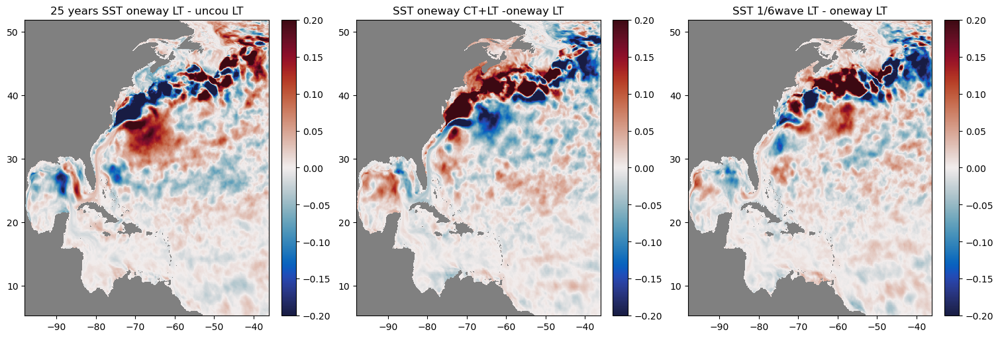

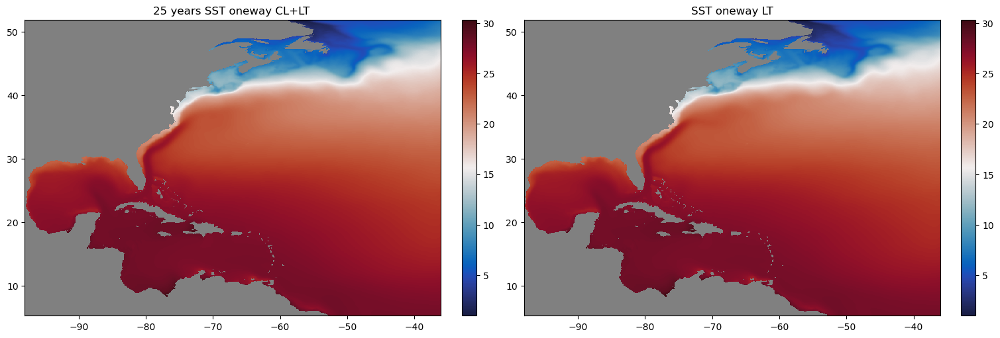

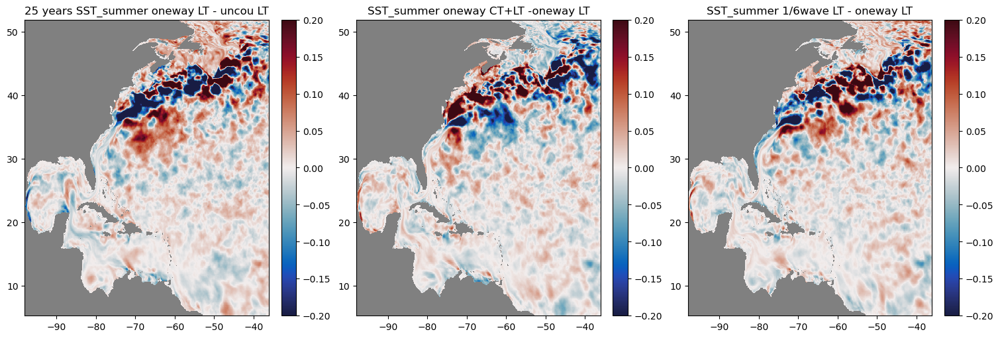

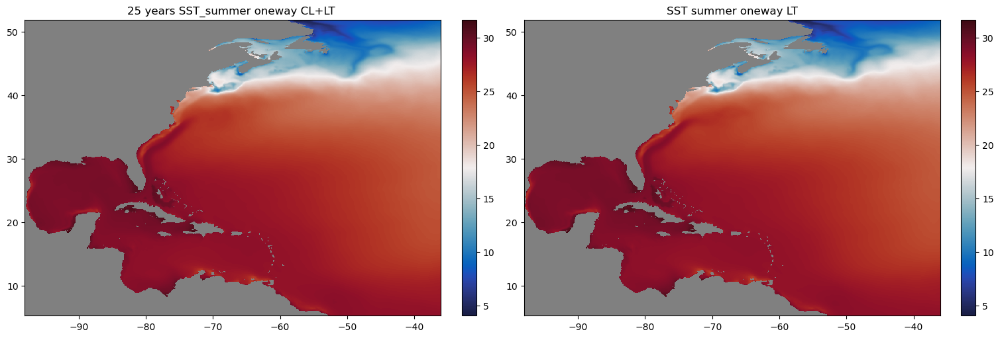

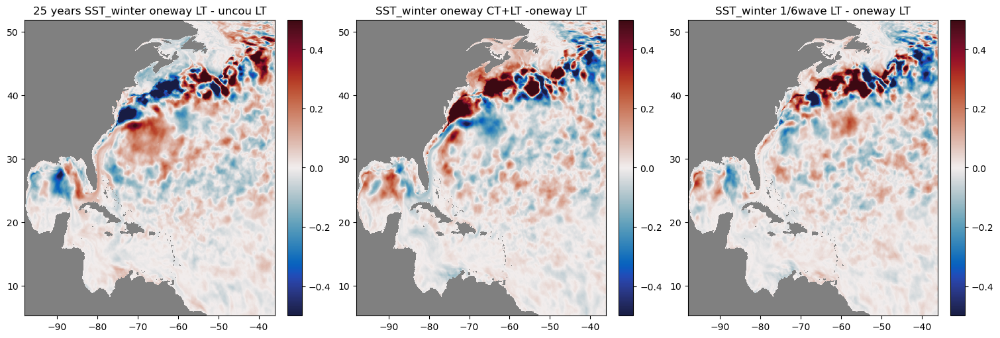

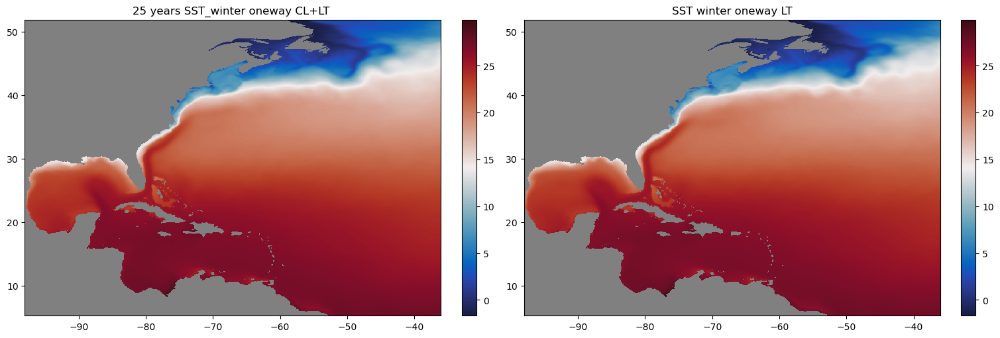

In [27]:
SST_uncou_ave= Dcombined_data_uncou['SST']
SST_summer_uncou_ave= Dsummer_data_uncou['SST']
SST_winter_uncou_ave= Dwinter_data_uncou['SST']

SST_oneway_all_ave= Dcombined_data_oneway_all['SST']
SST_summer_oneway_all_ave= Dsummer_data_oneway_all['SST']
SST_winter_oneway_all_ave= Dwinter_data_oneway_all['SST']

SST_oneway_ave= Dcombined_data_oneway['SST']
SST_summer_oneway_ave= Dsummer_data_oneway['SST']
SST_winter_oneway_ave= Dwinter_data_oneway['SST']

SST_6_wave_ave= Dcombined_data_6_wave['SST']
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST']
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST']

diff_SST_uncou_ave=SST_oneway_ave - SST_uncou_ave
diff_SST_all_ave=SST_oneway_all_ave-SST_oneway_ave
diff_SST_wave_ave=SST_6_wave_ave - SST_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('25 years SST oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('SST oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_wave_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('SST 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_SST_summer_uncou_ave=SST_summer_oneway_ave - SST_summer_uncou_ave
diff_SST_summer_all_ave=SST_summer_oneway_all_ave-SST_summer_oneway_ave
diff_SST_summer_wave_ave=SST_summer_6_wave_ave - SST_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('25 years SST_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('SST_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('SST_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_SST_winter_uncou_ave=SST_winter_oneway_ave - SST_winter_uncou_ave
diff_SST_winter_all_ave=SST_winter_oneway_all_ave-SST_winter_oneway_ave
diff_SST_winter_wave_ave=SST_winter_6_wave_ave - SST_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.5,vmax=0.5)
axes[0].set_title('25 years SST_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.5,vmax=0.5)
axes[1].set_title('SST_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.5,vmax=0.5)
axes[2].set_title('SST_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

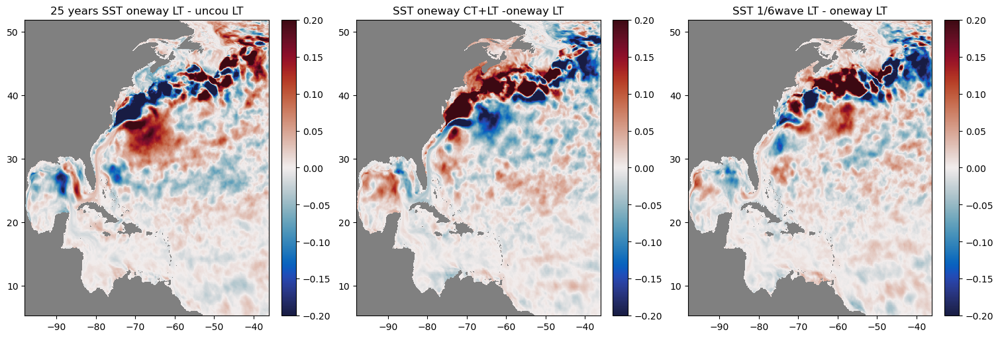

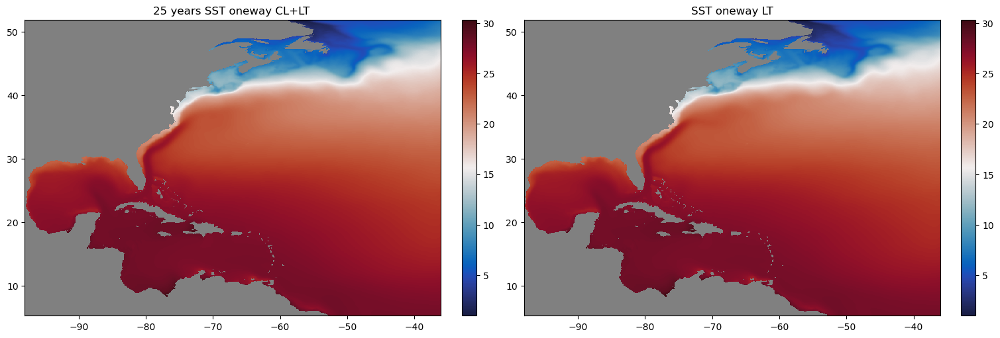

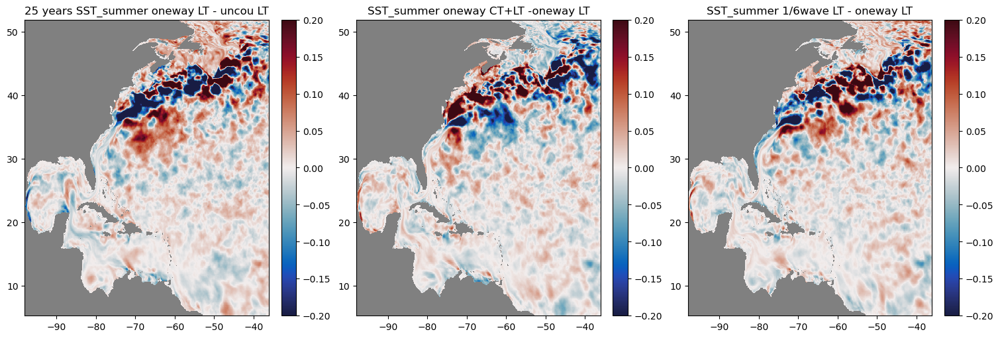

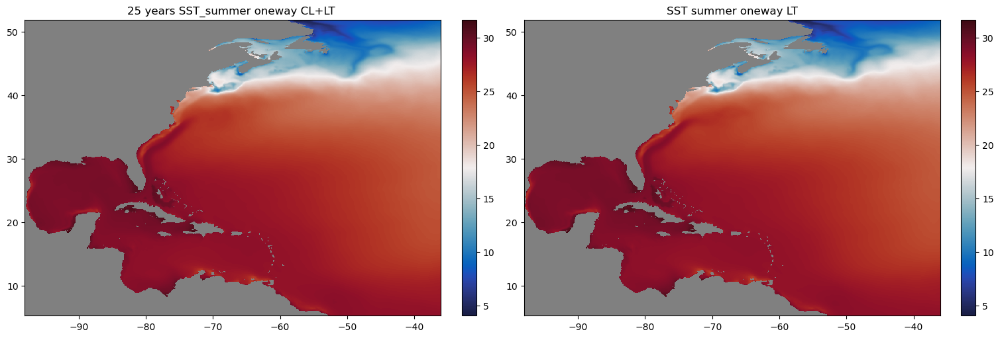

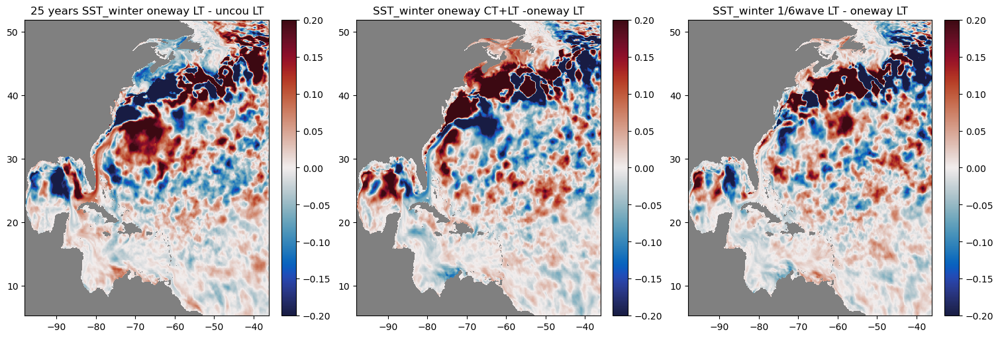

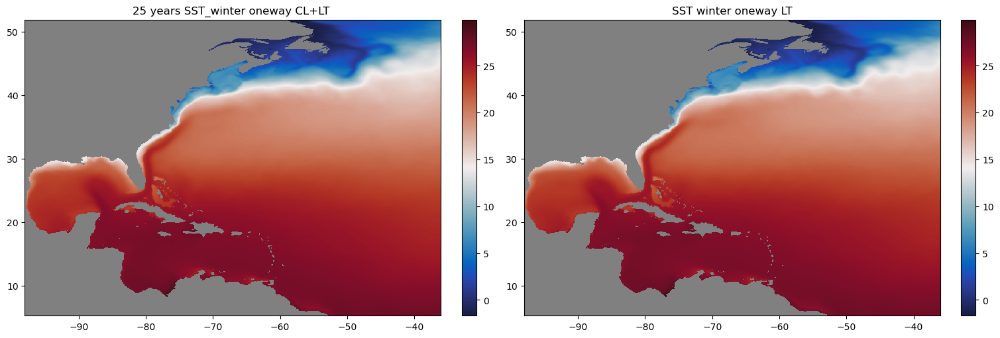

In [26]:
SST_uncou_ave= Dcombined_data_uncou['SST']
SST_summer_uncou_ave= Dsummer_data_uncou['SST']
SST_winter_uncou_ave= Dwinter_data_uncou['SST']

SST_oneway_all_ave= Dcombined_data_oneway_all['SST']
SST_summer_oneway_all_ave= Dsummer_data_oneway_all['SST']
SST_winter_oneway_all_ave= Dwinter_data_oneway_all['SST']

SST_oneway_ave= Dcombined_data_oneway['SST']
SST_summer_oneway_ave= Dsummer_data_oneway['SST']
SST_winter_oneway_ave= Dwinter_data_oneway['SST']

SST_6_wave_ave= Dcombined_data_6_wave['SST']
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST']
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST']

diff_SST_uncou_ave=SST_oneway_ave - SST_uncou_ave
diff_SST_all_ave=SST_oneway_all_ave-SST_oneway_ave
diff_SST_wave_ave=SST_6_wave_ave - SST_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('25 years SST oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('SST oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_wave_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('SST 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_SST_summer_uncou_ave=SST_summer_oneway_ave - SST_summer_uncou_ave
diff_SST_summer_all_ave=SST_summer_oneway_all_ave-SST_summer_oneway_ave
diff_SST_summer_wave_ave=SST_summer_6_wave_ave - SST_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('25 years SST_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('SST_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('SST_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_SST_winter_uncou_ave=SST_winter_oneway_ave - SST_winter_uncou_ave
diff_SST_winter_all_ave=SST_winter_oneway_all_ave-SST_winter_oneway_ave
diff_SST_winter_wave_ave=SST_winter_6_wave_ave - SST_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('25 years SST_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('SST_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('SST_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years SST_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

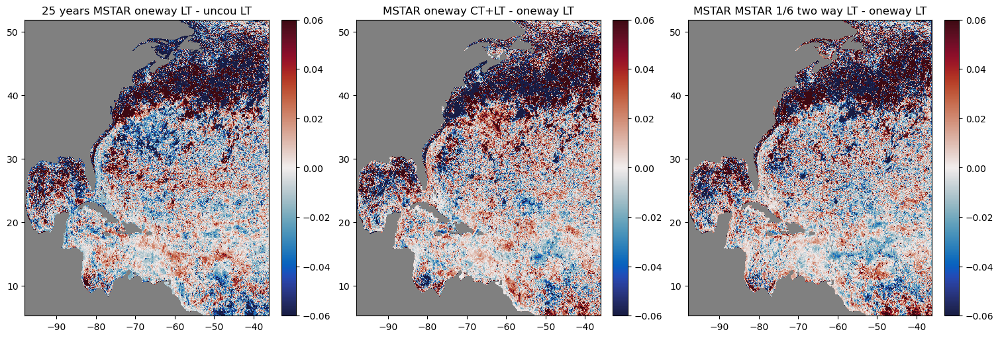

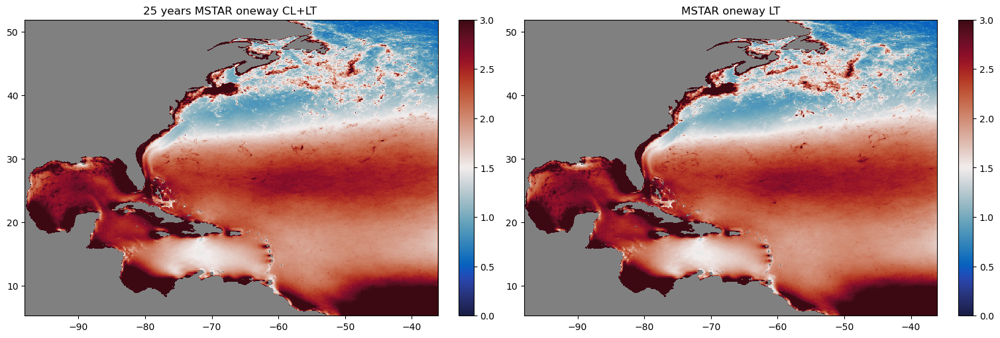

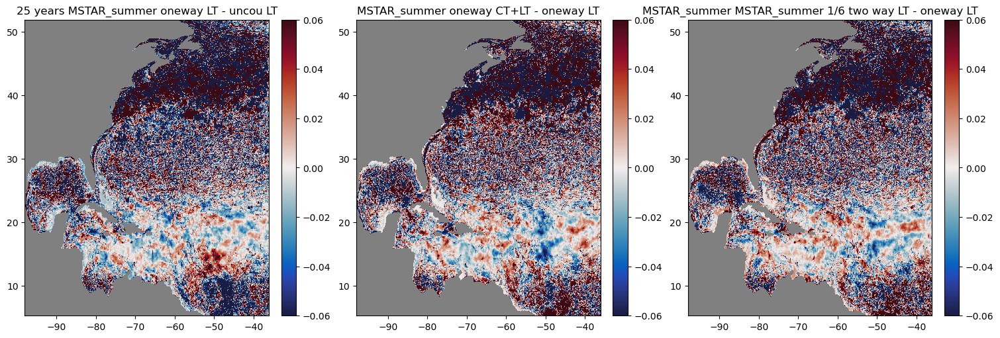

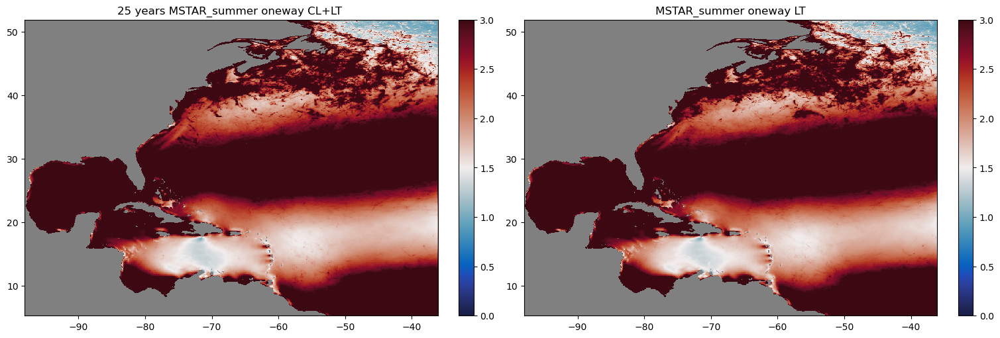

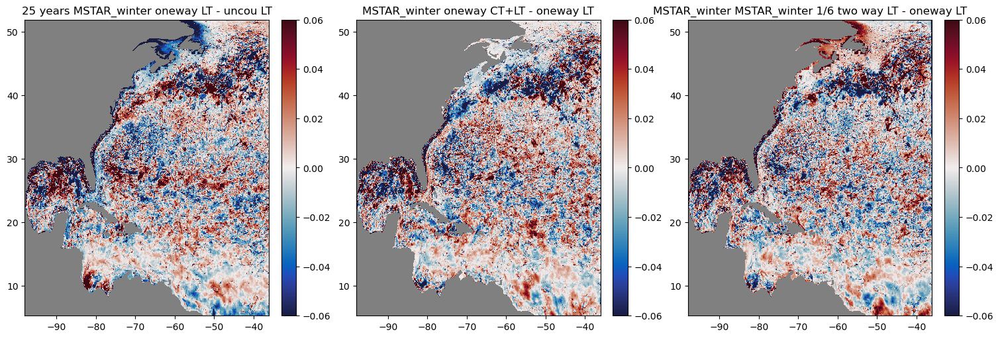

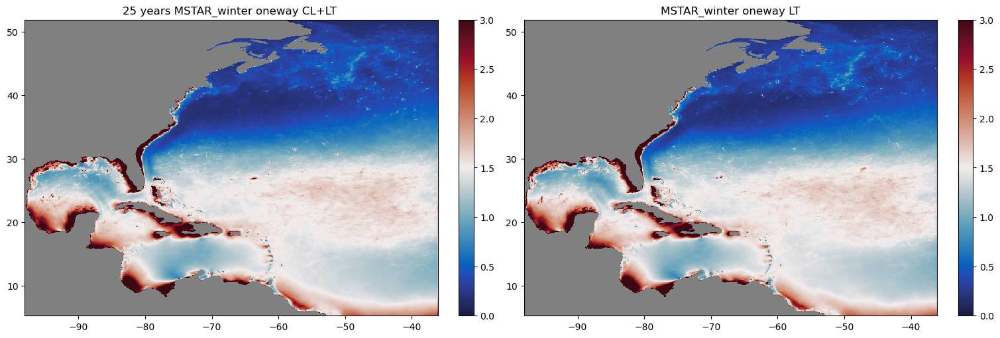

In [3]:
MSTAR_uncou= Mcombined_data_uncou['MSTAR']
MSTAR_summer_uncou= Msummer_data_uncou['MSTAR']
MSTAR_winter_uncou= Mwinter_data_uncou['MSTAR']
MSTAR_uncou_ave=MSTAR_uncou
MSTAR_summer_uncou_ave=MSTAR_summer_uncou
MSTAR_winter_uncou_ave=MSTAR_winter_uncou

MSTAR_oneway_all= Mcombined_data_oneway_all['MSTAR']
MSTAR_summer_oneway_all= Msummer_data_oneway_all['MSTAR']
MSTAR_winter_oneway_all= Mwinter_data_oneway_all['MSTAR']
MSTAR_oneway_all_ave=MSTAR_oneway_all
MSTAR_summer_oneway_all_ave=MSTAR_summer_oneway_all
MSTAR_winter_oneway_all_ave=MSTAR_winter_oneway_all

MSTAR_oneway= Mcombined_data_oneway['MSTAR']
MSTAR_summer_oneway= Msummer_data_oneway['MSTAR']
MSTAR_winter_oneway= Mwinter_data_oneway['MSTAR']
MSTAR_oneway_ave=MSTAR_oneway
MSTAR_summer_oneway_ave=MSTAR_summer_oneway
MSTAR_winter_oneway_ave=MSTAR_winter_oneway

MSTAR_6_wave= Mcombined_data_6_wave['MSTAR']
MSTAR_summer_6_wave= Msummer_data_6_wave['MSTAR']
MSTAR_winter_6_wave= Mwinter_data_6_wave['MSTAR']
MSTAR_6_wave_ave=MSTAR_6_wave
MSTAR_summer_6_wave_ave=MSTAR_summer_6_wave
MSTAR_winter_6_wave_ave=MSTAR_winter_6_wave


diff_MSTAR_uncou_ave=MSTAR_oneway_ave -MSTAR_uncou_ave
diff_MSTAR_all_ave=MSTAR_oneway_all_ave-MSTAR_oneway_ave
diff_MSTAR_wave_ave=MSTAR_6_wave_ave - MSTAR_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_uncou_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('25 years MSTAR oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_all_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('MSTAR oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[2].set_title('MSTAR MSTAR 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('25 years MSTAR oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('MSTAR oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_summer_uncou_ave=MSTAR_summer_oneway_ave -MSTAR_summer_uncou_ave
diff_MSTAR_summer_all_ave=MSTAR_summer_oneway_all_ave-MSTAR_summer_oneway_ave
diff_MSTAR_summer_wave_ave=MSTAR_summer_6_wave_ave - MSTAR_summer_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('25 years MSTAR_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('MSTAR_summer oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[2].set_title('MSTAR_summer MSTAR_summer 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_summer_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('25 years MSTAR_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_summer_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('MSTAR_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_winter_uncou_ave=MSTAR_winter_oneway_ave -MSTAR_winter_uncou_ave
diff_MSTAR_winter_all_ave=MSTAR_winter_oneway_all_ave-MSTAR_winter_oneway_ave
diff_MSTAR_winter_wave_ave=MSTAR_winter_6_wave_ave - MSTAR_winter_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('25 years MSTAR_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('MSTAR_winter oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[2].set_title('MSTAR_winter MSTAR_winter 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_winter_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('25 years MSTAR_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_winter_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('MSTAR_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()

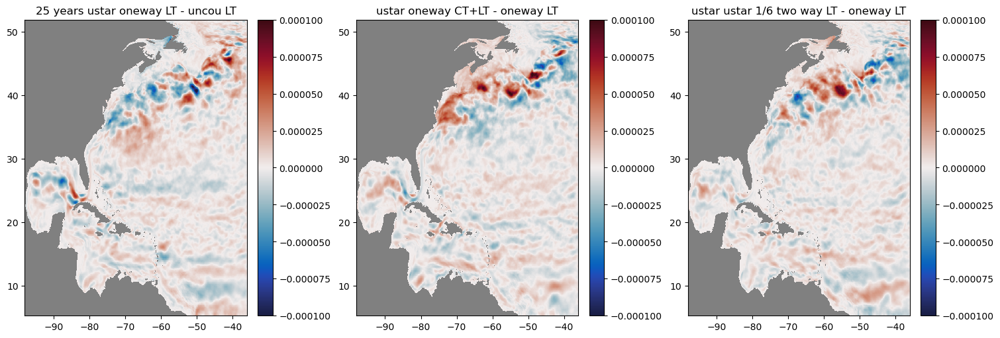

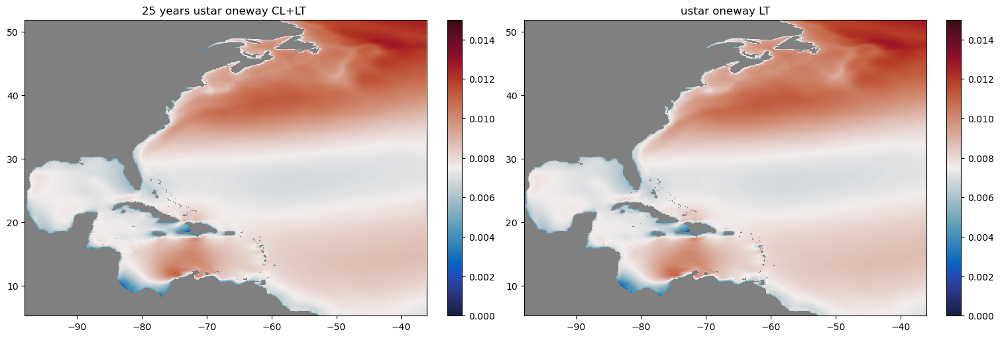

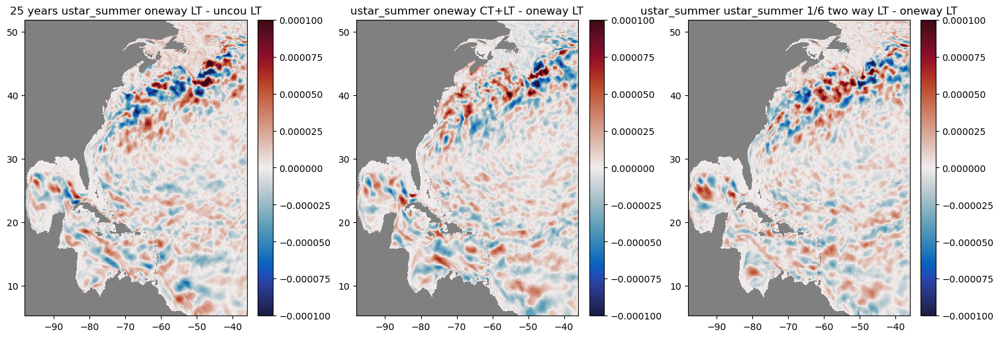

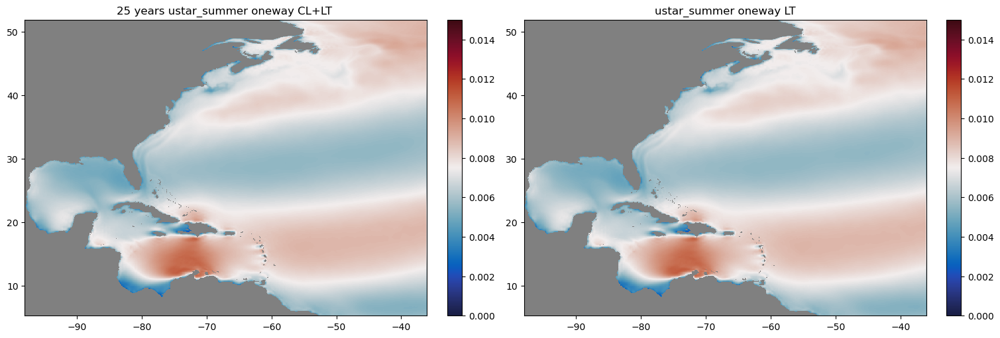

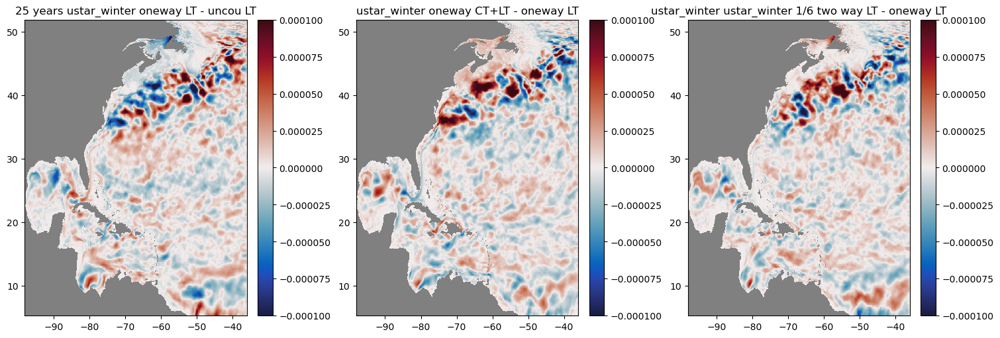

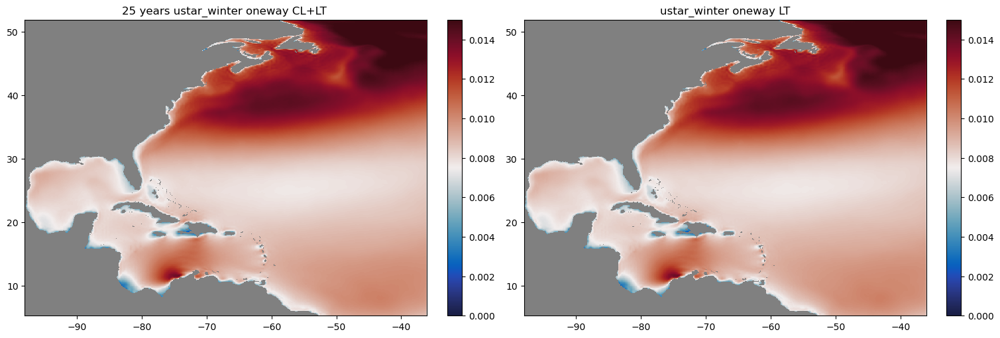

In [5]:
ustar_uncou= Mcombined_data_uncou['ustar']
ustar_summer_uncou= Msummer_data_uncou['ustar']
ustar_winter_uncou= Mwinter_data_uncou['ustar']
ustar_uncou_ave=ustar_uncou
ustar_summer_uncou_ave=ustar_summer_uncou
ustar_winter_uncou_ave=ustar_winter_uncou

ustar_oneway_all= Mcombined_data_oneway_all['ustar']
ustar_summer_oneway_all= Msummer_data_oneway_all['ustar']
ustar_winter_oneway_all= Mwinter_data_oneway_all['ustar']
ustar_oneway_all_ave=ustar_oneway_all
ustar_summer_oneway_all_ave=ustar_summer_oneway_all
ustar_winter_oneway_all_ave=ustar_winter_oneway_all

ustar_oneway= Mcombined_data_oneway['ustar']
ustar_summer_oneway= Msummer_data_oneway['ustar']
ustar_winter_oneway= Mwinter_data_oneway['ustar']
ustar_oneway_ave=ustar_oneway
ustar_summer_oneway_ave=ustar_summer_oneway
ustar_winter_oneway_ave=ustar_winter_oneway

ustar_6_wave= Mcombined_data_6_wave['ustar']
ustar_summer_6_wave= Msummer_data_6_wave['ustar']
ustar_winter_6_wave= Mwinter_data_6_wave['ustar']
ustar_6_wave_ave=ustar_6_wave
ustar_summer_6_wave_ave=ustar_summer_6_wave
ustar_winter_6_wave_ave=ustar_winter_6_wave


diff_ustar_uncou_ave=ustar_oneway_ave -ustar_uncou_ave
diff_ustar_all_ave=ustar_oneway_all_ave-ustar_oneway_ave
diff_ustar_wave_ave=ustar_6_wave_ave - ustar_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_uncou_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('25 years ustar oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_all_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ustar_wave_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[2].set_title('ustar ustar 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('25 years ustar oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,ustar_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_ustar_summer_uncou_ave=ustar_summer_oneway_ave -ustar_summer_uncou_ave
diff_ustar_summer_all_ave=ustar_summer_oneway_all_ave-ustar_summer_oneway_ave
diff_ustar_summer_wave_ave=ustar_summer_6_wave_ave - ustar_summer_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('25 years ustar_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar_summer oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ustar_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[2].set_title('ustar_summer ustar_summer 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_summer_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('25 years ustar_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,ustar_summer_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_ustar_winter_uncou_ave=ustar_winter_oneway_ave -ustar_winter_uncou_ave
diff_ustar_winter_all_ave=ustar_winter_oneway_all_ave-ustar_winter_oneway_ave
diff_ustar_winter_wave_ave=ustar_winter_6_wave_ave - ustar_winter_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ustar_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[0].set_title('25 years ustar_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ustar_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[1].set_title('ustar_winter oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ustar_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.0001,vmax=0.0001)
axes[2].set_title('ustar_winter ustar_winter 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ustar_winter_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[0].set_title('25 years ustar_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,ustar_winter_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.015)
axes[1].set_title('ustar_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()

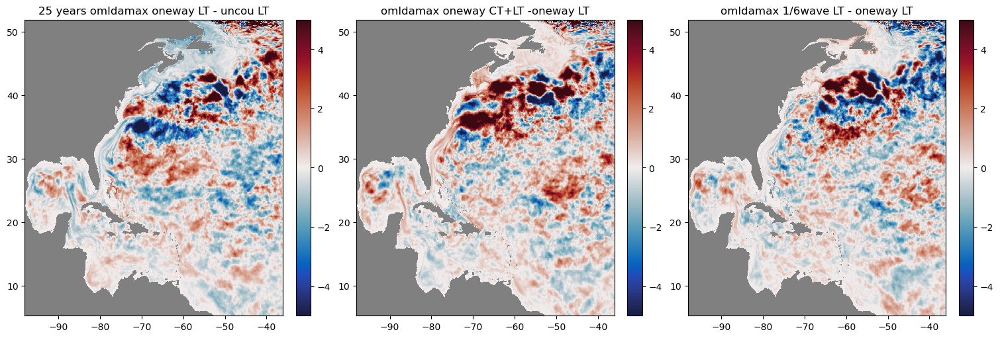

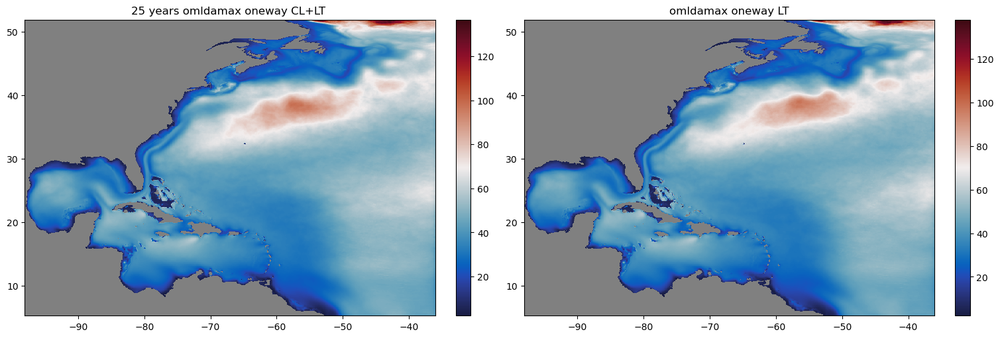

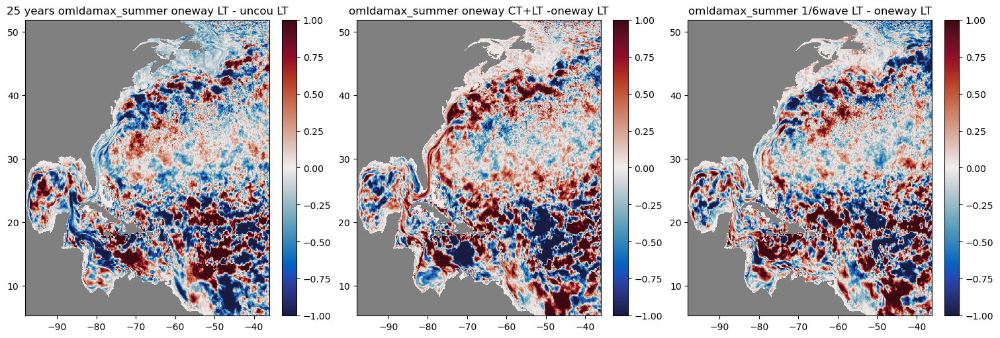

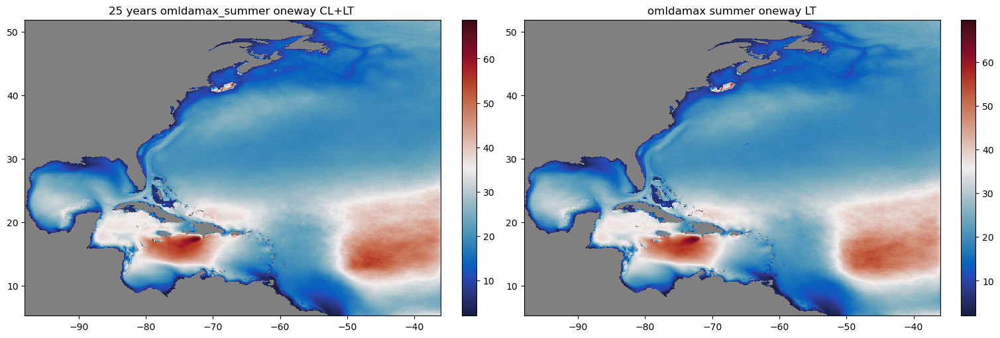

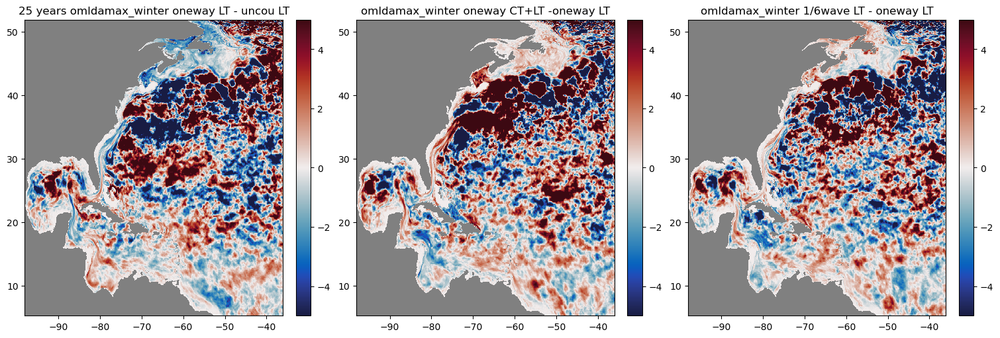

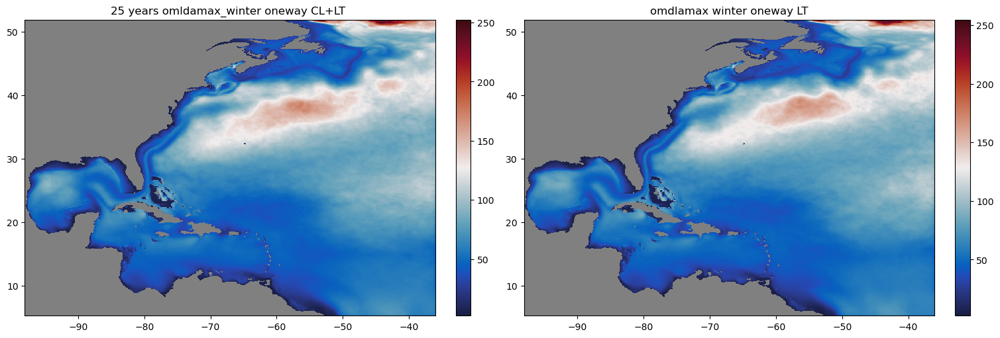

In [29]:
omldamax_uncou_ave= Dcombined_data_uncou['omldamax']
omldamax_summer_uncou_ave= Dsummer_data_uncou['omldamax']
omldamax_winter_uncou_ave= Dwinter_data_uncou['omldamax']

omldamax_oneway_all_ave= Dcombined_data_oneway_all['omldamax']
omldamax_summer_oneway_all_ave= Dsummer_data_oneway_all['omldamax']
omldamax_winter_oneway_all_ave= Dwinter_data_oneway_all['omldamax']

omldamax_oneway_ave= Dcombined_data_oneway['omldamax']
omldamax_summer_oneway_ave= Dsummer_data_oneway['omldamax']
omldamax_winter_oneway_ave= Dwinter_data_oneway['omldamax']

omldamax_6_wave_ave= Dcombined_data_6_wave['omldamax']
omldamax_summer_6_wave_ave= Dsummer_data_6_wave['omldamax']
omldamax_winter_6_wave_ave= Dwinter_data_6_wave['omldamax']

diff_omldamax_uncou_ave=omldamax_oneway_ave - omldamax_uncou_ave
diff_omldamax_all_ave=omldamax_oneway_all_ave-omldamax_oneway_ave
diff_omldamax_wave_ave=omldamax_6_wave_ave - omldamax_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_uncou_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[0].set_title('25 years omldamax oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_all_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[1].set_title('omldamax oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_wave_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[2].set_title('omldamax 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years omldamax oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_omldamax_summer_uncou_ave=omldamax_summer_oneway_ave - omldamax_summer_uncou_ave
diff_omldamax_summer_all_ave=omldamax_summer_oneway_all_ave-omldamax_summer_oneway_ave
diff_omldamax_summer_wave_ave=omldamax_summer_6_wave_ave - omldamax_summer_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('25 years omldamax_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('omldamax_summer oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_summer_wave_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('omldamax_summer 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_summer_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years omldamax_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_summer_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('omldamax summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_omldamax_winter_uncou_ave=omldamax_winter_oneway_ave - omldamax_winter_uncou_ave
diff_omldamax_winter_all_ave=omldamax_winter_oneway_all_ave-omldamax_winter_oneway_ave
diff_omldamax_winter_wave_ave=omldamax_winter_6_wave_ave - omldamax_winter_oneway_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[0].set_title('25 years omldamax_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_winter_all_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[1].set_title('omldamax_winter oneway CT+LT -oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_omldamax_winter_wave_ave, cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[2].set_title('omldamax_winter 1/6wave LT - oneway LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, omldamax_winter_oneway_all_ave  , cmap=cmap, shading='auto')
axes[0].set_title('25 years omldamax_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, omldamax_winter_oneway_ave, cmap=cmap, shading='auto')
axes[1].set_title('omdlamax winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

In [ ]:
def compute_weighted_mean_product_seasonal_MSTAR(pp_root, data_list):
    combined_sum = None
    combined_count = None

    summer_sum = None
    summer_count = None

    winter_sum = None
    winter_count = None

    for file_path in data_list:
        file_path = os.path.join(pp_root, file_path)
        if os.path.exists(file_path):
            try:
                ds = xr.open_dataset(file_path)

                if 'MSTAR' in ds and 'ustar' in ds:
                    mstar = ds['MSTAR']
                    ustar_cubed = ds['ustar'] ** 3
                    product = mstar * ustar_cubed

                    # --- All time ---
                    valid_count = product.notnull().sum(dim='time')
                    if valid_count.sum() > 0:
                        product_sum = product.sum(dim='time', skipna=True)

                        if combined_sum is None:
                            combined_sum = product_sum
                            combined_count = valid_count
                        else:
                            combined_sum += product_sum
                            combined_count += valid_count

                    # --- Summer (JJA) ---
                    summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                    product_summer = summer['MSTAR'] * (summer['ustar'] ** 3)
                    summer_valid = product_summer.notnull().sum(dim='time')

                    if summer_valid.sum() > 0:
                        summer_sum_tmp = product_summer.sum(dim='time', skipna=True)

                        if summer_sum is None:
                            summer_sum = summer_sum_tmp
                            summer_count = summer_valid
                        else:
                            summer_sum += summer_sum_tmp
                            summer_count += summer_valid

                    # --- Winter (DJF) ---
                    winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                    product_winter = winter['MSTAR'] * (winter['ustar'] ** 3)
                    winter_valid = product_winter.notnull().sum(dim='time')

                    if winter_valid.sum() > 0:
                        winter_sum_tmp = product_winter.sum(dim='time', skipna=True)

                        if winter_sum is None:
                            winter_sum = winter_sum_tmp
                            winter_count = winter_valid
                        else:
                            winter_sum += winter_sum_tmp
                            winter_count += winter_valid

                else:
                    print(f"Missing variables in {file_path}")

                ds.close()

            except Exception as e:
                print(f"Error reading {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    # Final averages
    combined_data = combined_sum / combined_count if combined_count is not None else None
    summer_data = summer_sum / summer_count if summer_count is not None else None
    winter_data = winter_sum / winter_count if winter_count is not None else None

    return combined_data, summer_data, winter_data
def compute_weighted_mean_product_seasonal_MSTAR(pp_root, data_list):
    combined_sum = None
    combined_count = None

    summer_sum = None
    summer_count = None

    winter_sum = None
    winter_count = None

    for file_path in data_list:
        file_path = os.path.join(pp_root, file_path)
        if os.path.exists(file_path):
            try:
                ds = xr.open_dataset(file_path)

                if 'MSTAR' in ds and 'ustar' in ds:
                    mstar = ds['MSTAR']
                    ustar_cubed = ds['ustar'] ** 3
                    product = mstar * ustar_cubed

                    # --- All time ---
                    valid_count = product.notnull().sum(dim='time')
                    if valid_count.sum() > 0:
                        product_sum = product.sum(dim='time', skipna=True)

                        if combined_sum is None:
                            combined_sum = product_sum
                            combined_count = valid_count
                        else:
                            combined_sum += product_sum
                            combined_count += valid_count

                    # --- Summer (JJA) ---
                    summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                    product_summer = summer['MSTAR'] * (summer['ustar'] ** 3)
                    summer_valid = product_summer.notnull().sum(dim='time')

                    if summer_valid.sum() > 0:
                        summer_sum_tmp = product_summer.sum(dim='time', skipna=True)

                        if summer_sum is None:
                            summer_sum = summer_sum_tmp
                            summer_count = summer_valid
                        else:
                            summer_sum += summer_sum_tmp
                            summer_count += summer_valid

                    # --- Winter (DJF) ---
                    winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                    product_winter = winter['MSTAR'] * (winter['ustar'] ** 3)
                    winter_valid = product_winter.notnull().sum(dim='time')

                    if winter_valid.sum() > 0:
                        winter_sum_tmp = product_winter.sum(dim='time', skipna=True)

                        if winter_sum is None:
                            winter_sum = winter_sum_tmp
                            winter_count = winter_valid
                        else:
                            winter_sum += winter_sum_tmp
                            winter_count += winter_valid

                else:
                    print(f"Missing variables in {file_path}")

                ds.close()

            except Exception as e:
                print(f"Error reading {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    # Final averages
    combined_data = combined_sum / combined_count if combined_count is not None else None
    summer_data = summer_sum / summer_count if summer_count is not None else None
    winter_data = winter_sum / winter_count if winter_count is not None else None

    return combined_data, summer_data, winter_data



In [2]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_oneway_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_oneway_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
pp_root_oneway_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_all/"
pp_root_oneway="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12_oneway_dT"


def read_and_extract_data_weightedmean(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        mean_sum = None
        count_sum = None
        summer_mean_sum = None
        summer_count_sum = None
        winter_mean_sum = None
        winter_count_sum = None

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        # Compute valid count (to weight the mean correctly)
                        count_valid = ds[var_name].notnull().sum(dim='time')
                        
                        if count_valid.sum() > 0:
                            yearly_mean = ds[var_name].sum(dim='time', skipna=True)
                            
                            if mean_sum is None:
                                mean_sum = yearly_mean
                                count_sum = count_valid
                            else:
                                mean_sum += yearly_mean
                                count_sum += count_valid

                        # Summer (JJA): June, July, August
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        summer_count_valid = summer[var_name].notnull().sum(dim='time')
                        
                        if summer_count_valid.sum() > 0:
                            summer_mean = summer[var_name].sum(dim='time', skipna=True)
                            
                            if summer_mean_sum is None:
                                summer_mean_sum = summer_mean
                                summer_count_sum = summer_count_valid
                            else:
                                summer_mean_sum += summer_mean
                                summer_count_sum += summer_count_valid

                        # Winter (DJF): December, January, February
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        winter_count_valid = winter[var_name].notnull().sum(dim='time')
                        
                        if winter_count_valid.sum() > 0:
                            winter_mean = winter[var_name].sum(dim='time', skipna=True)
                            
                            if winter_mean_sum is None:
                                winter_mean_sum = winter_mean
                                winter_count_sum = winter_count_valid
                            else:
                                winter_mean_sum += winter_mean
                                winter_count_sum += winter_count_valid

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Compute final means
        combined_data[var_name] = mean_sum / count_sum if count_sum is not None else None
        summer_data[var_name] = summer_mean_sum / summer_count_sum if summer_count_sum is not None else None
        winter_data[var_name] = winter_mean_sum / winter_count_sum if winter_count_sum is not None else None

    return combined_data, summer_data, winter_data

Ddata_list = [
  
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',


]

Mdata_list = [
  
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',


]
WMdata_list = [
   
    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
 
]

WDdata_list = [
  
    '20040101_results/20040101.ocean_daily.nc',
    '20040701_results/20040701.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc',
   
]

One_D_list=[
  

    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_D_all_list=[
  
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_M_list=[
   
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc', 
]
One_M_all_list=[
   
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc'
]

# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR','La_turbulent','surface_stokes_x','surface_stokes_y']
# variables_month = ['ssh','speed','MLD_EN1','MSTAR','ustar']
# variables_daily = ['omldamax','SST']
variables_month = ['MSTAR_LT','MSTAR']

# Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Ddata_list, variables_daily)
Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Mdata_list, variables_month)

# Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WDdata_list, variables_daily)
Mcombined_data_6_wave, Msummer_data_6_wave, Mwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WMdata_list, variables_month)

# Dcombined_data_oneway_all, Dsummer_data_oneway_all, Dwinter_data_oneway_all = read_and_extract_data_weightedmean(pp_root_oneway_all, One_D_all_list, variables_daily)
Mcombined_data_oneway_all, Msummer_data_oneway_all, Mwinter_data_oneway_all = read_and_extract_data_weightedmean(pp_root_oneway_all, One_M_all_list, variables_month)

# Dcombined_data_oneway, Dsummer_data_oneway, Dwinter_data_oneway = read_and_extract_data_weightedmean(pp_root_oneway, One_D_list, variables_daily)
Mcombined_data_oneway, Msummer_data_oneway, Mwinter_data_oneway = read_and_extract_data_weightedmean(pp_root_oneway, One_M_list, variables_month)


ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']



/vftmp/Qian.Xiao/pid3645304/ipykernel_3661259/787086416.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3645304/ipykernel_3661259/787086416.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3645304/ipykernel_3661259/787086416.py:42: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid3645304/ipykernel_3661259/787086416.py:42: FutureWarning: In a future version of xarray decode_

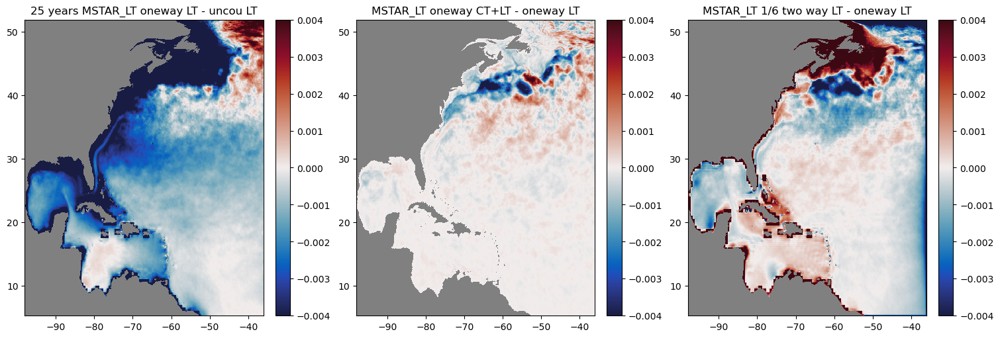

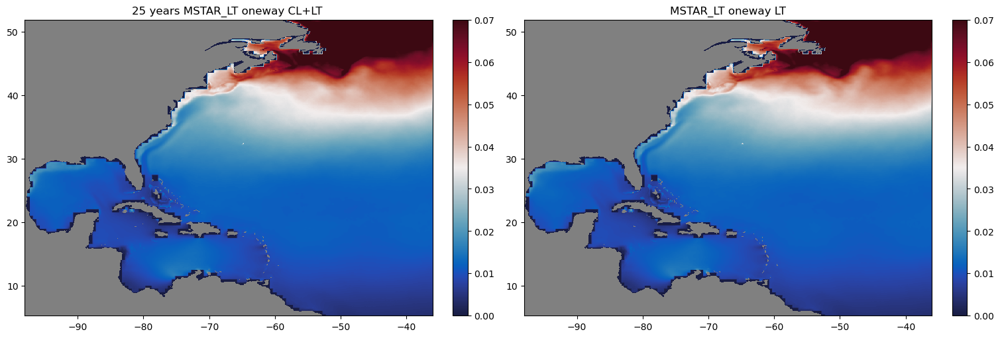

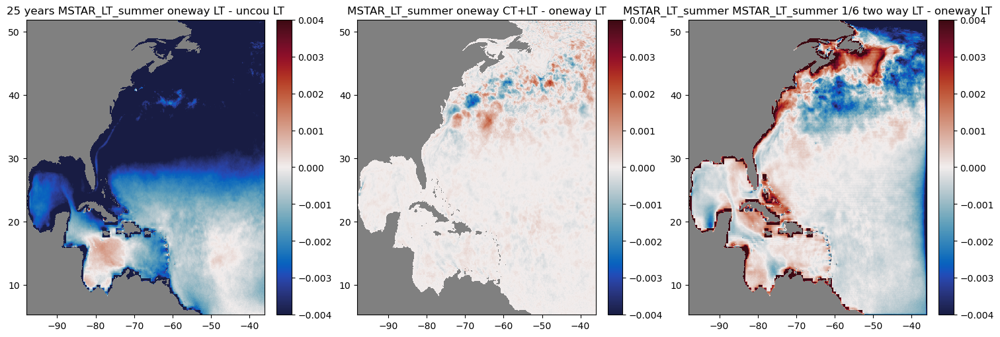

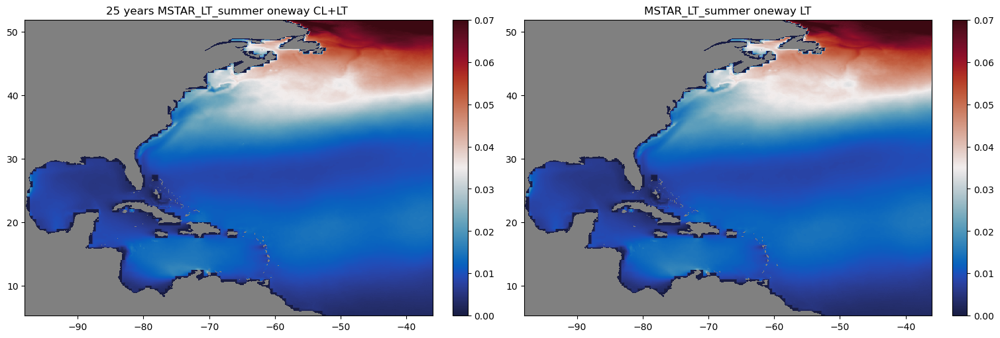

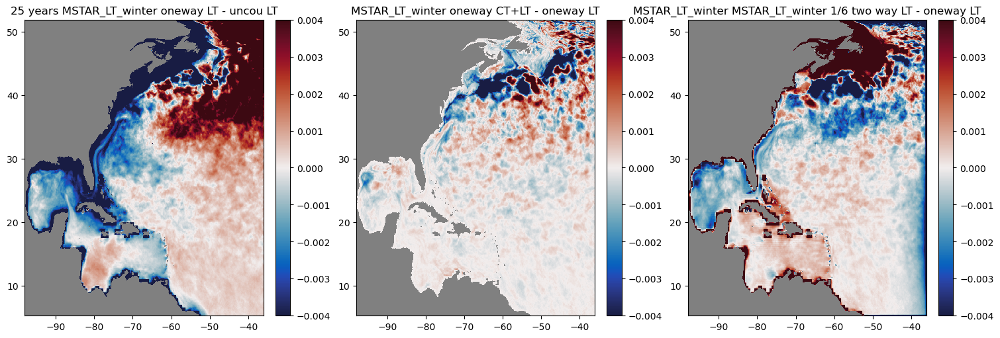

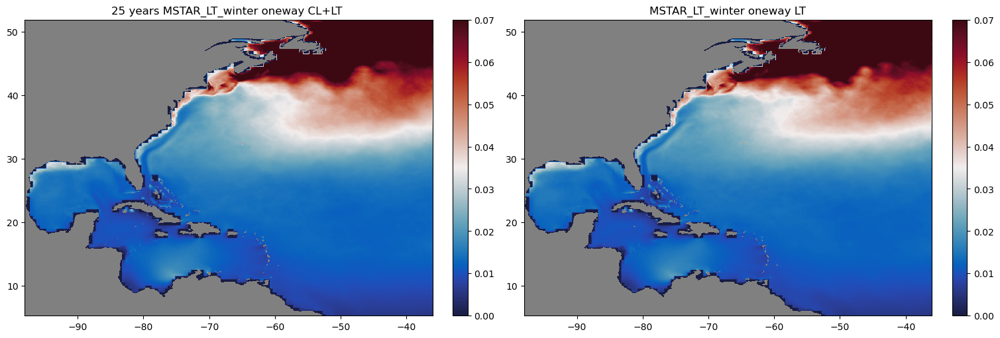

In [4]:
MSTAR_LT_uncou= Mcombined_data_uncou['MSTAR_LT']
MSTAR_LT_summer_uncou= Msummer_data_uncou['MSTAR_LT']
MSTAR_LT_winter_uncou= Mwinter_data_uncou['MSTAR_LT']
MSTAR_LT_uncou_ave=MSTAR_LT_uncou
MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_uncou
MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_uncou

MSTAR_LT_oneway_all= Mcombined_data_oneway_all['MSTAR_LT']
MSTAR_LT_summer_oneway_all= Msummer_data_oneway_all['MSTAR_LT']
MSTAR_LT_winter_oneway_all= Mwinter_data_oneway_all['MSTAR_LT']
MSTAR_LT_oneway_all_ave=MSTAR_LT_oneway_all
MSTAR_LT_summer_oneway_all_ave=MSTAR_LT_summer_oneway_all
MSTAR_LT_winter_oneway_all_ave=MSTAR_LT_winter_oneway_all

MSTAR_LT_oneway= Mcombined_data_oneway['MSTAR_LT']
MSTAR_LT_summer_oneway= Msummer_data_oneway['MSTAR_LT']
MSTAR_LT_winter_oneway= Mwinter_data_oneway['MSTAR_LT']
MSTAR_LT_oneway_ave=MSTAR_LT_oneway
MSTAR_LT_summer_oneway_ave=MSTAR_LT_summer_oneway
MSTAR_LT_winter_oneway_ave=MSTAR_LT_winter_oneway

MSTAR_LT_6_wave= Mcombined_data_6_wave['MSTAR_LT']
MSTAR_LT_summer_6_wave= Msummer_data_6_wave['MSTAR_LT']
MSTAR_LT_winter_6_wave= Mwinter_data_6_wave['MSTAR_LT']
MSTAR_LT_6_wave_ave=MSTAR_LT_6_wave
MSTAR_LT_summer_6_wave_ave=MSTAR_LT_summer_6_wave
MSTAR_LT_winter_6_wave_ave=MSTAR_LT_winter_6_wave


diff_MSTAR_LT_uncou_ave=MSTAR_LT_oneway_ave -MSTAR_LT_uncou_ave
diff_MSTAR_LT_all_ave=MSTAR_LT_oneway_all_ave-MSTAR_LT_oneway_ave
diff_MSTAR_LT_wave_ave=MSTAR_LT_6_wave_ave - MSTAR_LT_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_uncou_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('25 years MSTAR_LT oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_all_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_LT 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[0].set_title('25 years MSTAR_LT oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_LT_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[1].set_title('MSTAR_LT oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_oneway_ave -MSTAR_LT_summer_uncou_ave
diff_MSTAR_LT_summer_all_ave=MSTAR_LT_summer_oneway_all_ave-MSTAR_LT_summer_oneway_ave
diff_MSTAR_LT_summer_wave_ave=MSTAR_LT_summer_6_wave_ave - MSTAR_LT_summer_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('25 years MSTAR_LT_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_summer oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_LT_summer MSTAR_LT_summer 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[0].set_title('25 years MSTAR_LT_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_LT_summer_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[1].set_title('MSTAR_LT_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_oneway_ave -MSTAR_LT_winter_uncou_ave
diff_MSTAR_LT_winter_all_ave=MSTAR_LT_winter_oneway_all_ave-MSTAR_LT_winter_oneway_ave
diff_MSTAR_LT_winter_wave_ave=MSTAR_LT_winter_6_wave_ave - MSTAR_LT_winter_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('25 years MSTAR_LT_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_winter oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_LT_winter MSTAR_LT_winter 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_oneway_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[0].set_title('25 years MSTAR_LT_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_LT_winter_oneway_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[1].set_title('MSTAR_LT_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()

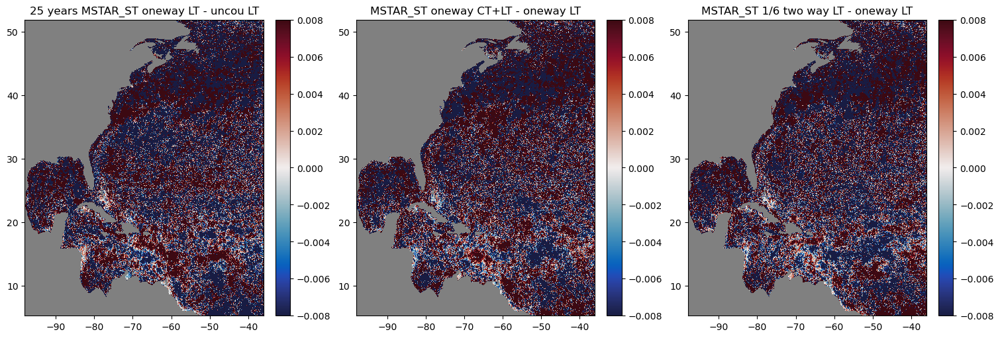

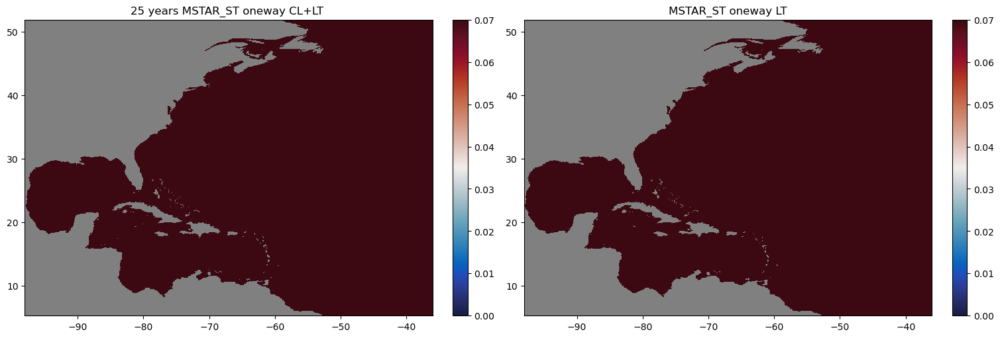

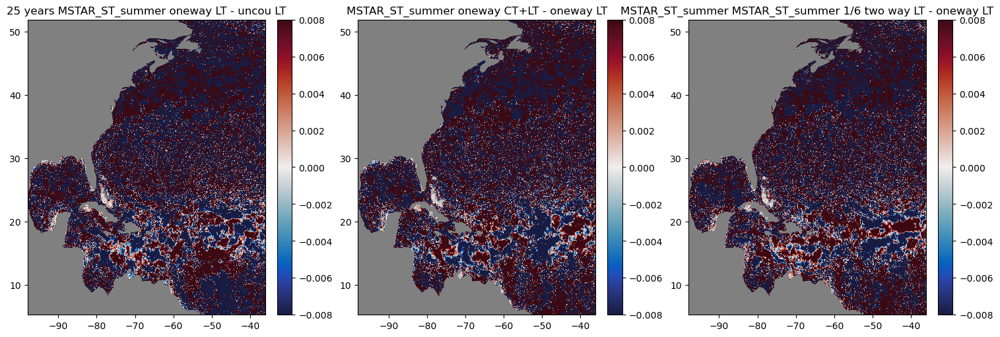

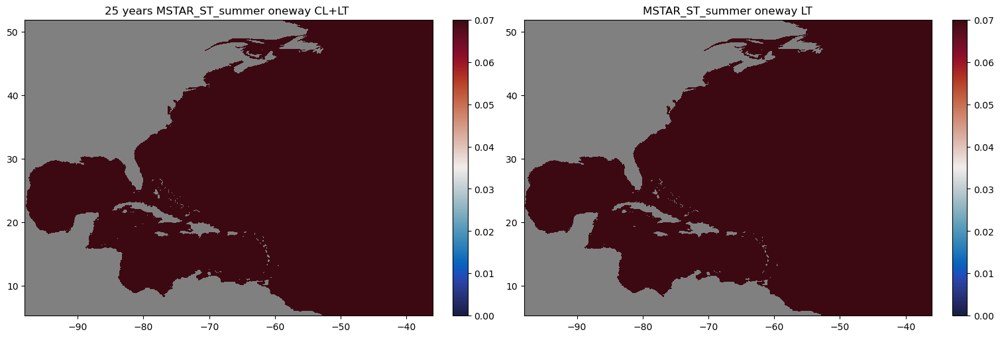

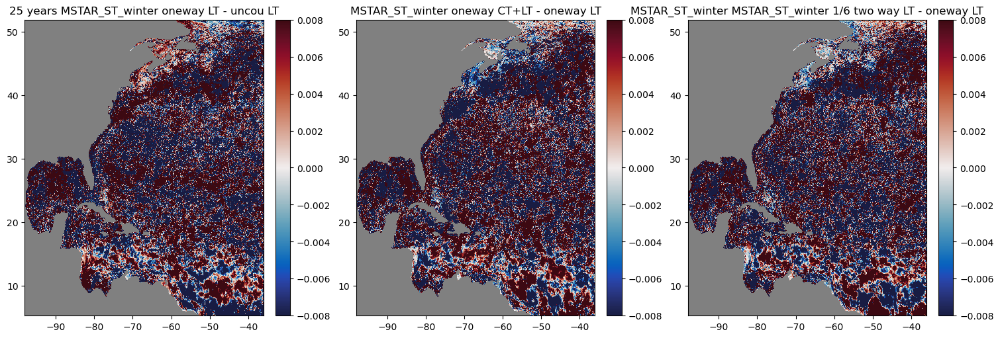

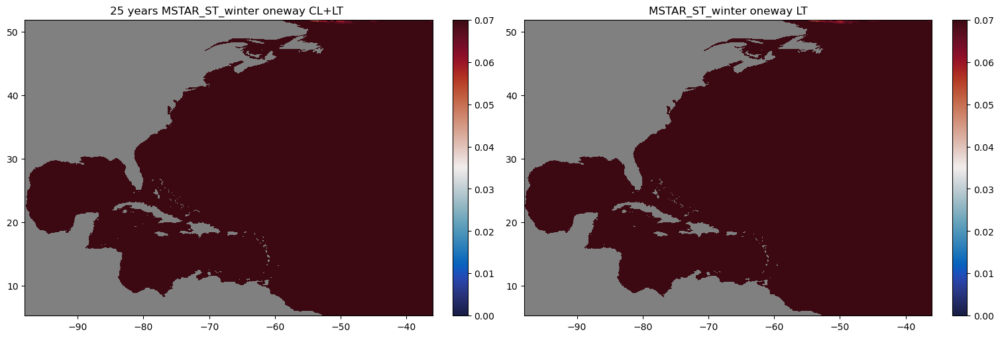

In [15]:
MSTAR_uncou= Mcombined_data_uncou['MSTAR']
MSTAR_summer_uncou= Msummer_data_uncou['MSTAR']
MSTAR_winter_uncou= Mwinter_data_uncou['MSTAR']
MSTAR_ST_uncou_ave=MSTAR_uncou-MSTAR_LT_uncou
MSTAR_ST_summer_uncou_ave=MSTAR_summer_uncou-MSTAR_LT_summer_uncou
MSTAR_ST_winter_uncou_ave=MSTAR_winter_uncou-MSTAR_LT_winter_uncou


MSTAR_6_wave= Mcombined_data_6_wave['MSTAR']
MSTAR_summer_6_wave= Msummer_data_6_wave['MSTAR']
MSTAR_winter_6_wave= Mwinter_data_6_wave['MSTAR']
MSTAR_ST_6_wave_ave=MSTAR_6_wave-MSTAR_LT_6_wave
MSTAR_ST_summer_6_wave_ave=MSTAR_summer_6_wave-MSTAR_LT_summer_6_wave
MSTAR_ST_winter_6_wave_ave=MSTAR_winter_6_wave-MSTAR_LT_winter_6_wave

MSTAR_oneway= Mcombined_data_oneway['MSTAR']
MSTAR_summer_oneway= Msummer_data_oneway['MSTAR']
MSTAR_winter_oneway= Mwinter_data_oneway['MSTAR']
MSTAR_ST_oneway_ave=MSTAR_oneway-MSTAR_LT_oneway
MSTAR_ST_summer_oneway_ave=MSTAR_summer_oneway-MSTAR_LT_summer_oneway
MSTAR_ST_winter_oneway_ave=MSTAR_winter_oneway-MSTAR_LT_winter_oneway

MSTAR_oneway_all= Mcombined_data_oneway_all['MSTAR']
MSTAR_summer_oneway_all= Msummer_data_oneway_all['MSTAR']
MSTAR_winter_oneway_all= Mwinter_data_oneway_all['MSTAR']
MSTAR_ST_oneway_all_ave=MSTAR_oneway_all-MSTAR_LT_oneway_all
MSTAR_ST_summer_oneway_all_ave=MSTAR_summer_oneway_all-MSTAR_LT_summer_oneway_all
MSTAR_ST_winter_oneway_all_ave=MSTAR_winter_oneway_all-MSTAR_LT_winter_oneway_all


diff_MSTAR_ST_uncou_ave=MSTAR_ST_oneway_ave -MSTAR_ST_uncou_ave
diff_MSTAR_ST_all_ave=MSTAR_ST_oneway_all_ave-MSTAR_ST_oneway_ave
diff_MSTAR_ST_wave_ave=MSTAR_ST_6_wave_ave - MSTAR_ST_oneway_ave
abs_max=0.075
avmin,avmax=0,3

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_uncou_ave , cmap=cmap, shading='auto',vmin=vmin, vmax=vmax)
axes[0].set_title('25 years MSTAR_ST oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_all_ave, cmap=cmap, shading='auto',vmin=vmin, vmax=vmax)
axes[1].set_title('MSTAR_ST oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_ST 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_oneway_all_ave , cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[0].set_title('25 years MSTAR_ST oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_ST_oneway_ave, cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_ST_summer_uncou_ave=MSTAR_ST_summer_oneway_ave -MSTAR_ST_summer_uncou_ave
diff_MSTAR_ST_summer_all_ave=MSTAR_ST_summer_oneway_all_ave-MSTAR_ST_summer_oneway_ave
diff_MSTAR_ST_summer_wave_ave=MSTAR_ST_summer_6_wave_ave - MSTAR_ST_summer_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('25 years MSTAR_ST_summer oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_ST_summer oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_summer_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_ST_summer MSTAR_ST_summer 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_summer_oneway_all_ave , cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[0].set_title('25 years MSTAR_ST_summer oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_ST_summer_oneway_ave, cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_summer oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_ST_winter_uncou_ave=MSTAR_ST_winter_oneway_ave -MSTAR_ST_winter_uncou_ave
diff_MSTAR_ST_winter_all_ave=MSTAR_ST_winter_oneway_all_ave-MSTAR_ST_winter_oneway_ave
diff_MSTAR_ST_winter_wave_ave=MSTAR_ST_winter_6_wave_ave - MSTAR_ST_winter_oneway_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('25 years MSTAR_ST_winter oneway LT - uncou LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_ST_winter oneway CT+LT - oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_ST_winter_wave_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[2].set_title('MSTAR_ST_winter MSTAR_ST_winter 1/6 two way LT - oneway LT')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_ST_winter_oneway_all_ave , cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[0].set_title('25 years MSTAR_ST_winter oneway CL+LT ')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y,MSTAR_ST_winter_oneway_ave, cmap=cmap, shading='auto',vmin=avmin, vmax=avmax)
axes[1].set_title('MSTAR_ST_winter oneway LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()